In [1]:
import pandas as pd

In [2]:
all_data = pd.read_csv("covidconfirmed.csv")

### Check datatypes

In [3]:
all_data.dtypes

countyFIPS      int64
County Name    object
State          object
StateFIPS       int64
22/01/2020      int64
                ...  
13/06/2022      int64
14/06/2022      int64
15/06/2022      int64
16/06/2022      int64
17/06/2022      int64
Length: 882, dtype: object

In [4]:
all_data.head()

,countyFIPS,County Name,State,StateFIPS,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,...,08/06/2022,09/06/2022,10/06/2022,11/06/2022,12/06/2022,13/06/2022,14/06/2022,15/06/2022,16/06/2022,17/06/2022
0,0,Statewide Unallocated,AL,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1001,Autauga County,AL,1,0,0,0,0,0,0,...,16065,16084,16095,16095,16095,16134,16158,16174,16193,16211
2,1003,Baldwin County,AL,1,0,0,0,0,0,0,...,57024,57079,57166,57166,57166,57366,57453,57554,57637,57726
3,1005,Barbour County,AL,1,0,0,0,0,0,0,...,5734,5744,5748,5748,5748,5757,5764,5769,5771,5782
4,1007,Bibb County,AL,1,0,0,0,0,0,0,...,6540,6544,6547,6547,6547,6565,6573,6583,6596,6611


### Selects Florida data, then removes first row "Statewide Unallocated" 

In [5]:
fl = all_data.loc[all_data["State"] =="FL"]
fl = fl.iloc[1: , :]
fl

,countyFIPS,County Name,State,StateFIPS,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,...,08/06/2022,09/06/2022,10/06/2022,11/06/2022,12/06/2022,13/06/2022,14/06/2022,15/06/2022,16/06/2022,17/06/2022
330,12001,Alachua County,FL,12,0,0,0,0,0,0,...,71531,71531,71531,71531,71531,71531,71531,71531,71531,73353
331,12003,Baker County,FL,12,0,0,0,0,0,0,...,8786,8786,8786,8786,8786,8786,8786,8786,8786,8890
332,12005,Bay County,FL,12,0,0,0,0,0,0,...,46729,46729,46729,46729,46729,46729,46729,46729,46729,47484
333,12007,Bradford County,FL,12,0,0,0,0,0,0,...,7639,7639,7639,7639,7639,7639,7639,7639,7639,7723
334,12009,Brevard County,FL,12,0,0,0,0,0,0,...,141879,141879,141879,141879,141879,141879,141879,141879,141879,145889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
392,12125,Union County,FL,12,0,0,0,0,0,0,...,4354,4354,4354,4354,4354,4354,4354,4354,4354,4396
393,12127,Volusia County,FL,12,0,0,0,0,0,0,...,122496,122496,122496,122496,122496,122496,122496,122496,122496,125956
394,12129,Wakulla County,FL,12,0,0,0,0,0,0,...,10158,10158,10158,10158,10158,10158,10158,10158,10158,10298
395,12131,Walton County,FL,12,0,0,0,0,0,0,...,16858,16858,16858,16858,16858,16858,16858,16858,16858,17101


In [6]:
fl_total = fl #.groupby('County Name').sum()
fl_total = fl_total.drop(['countyFIPS', 'StateFIPS'], axis=1)
fl_total

,County Name,State,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,28/01/2020,29/01/2020,...,08/06/2022,09/06/2022,10/06/2022,11/06/2022,12/06/2022,13/06/2022,14/06/2022,15/06/2022,16/06/2022,17/06/2022
330,Alachua County,FL,0,0,0,0,0,0,0,0,...,71531,71531,71531,71531,71531,71531,71531,71531,71531,73353
331,Baker County,FL,0,0,0,0,0,0,0,0,...,8786,8786,8786,8786,8786,8786,8786,8786,8786,8890
332,Bay County,FL,0,0,0,0,0,0,0,0,...,46729,46729,46729,46729,46729,46729,46729,46729,46729,47484
333,Bradford County,FL,0,0,0,0,0,0,0,0,...,7639,7639,7639,7639,7639,7639,7639,7639,7639,7723
334,Brevard County,FL,0,0,0,0,0,0,0,0,...,141879,141879,141879,141879,141879,141879,141879,141879,141879,145889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
392,Union County,FL,0,0,0,0,0,0,0,0,...,4354,4354,4354,4354,4354,4354,4354,4354,4354,4396
393,Volusia County,FL,0,0,0,0,0,0,0,0,...,122496,122496,122496,122496,122496,122496,122496,122496,122496,125956
394,Wakulla County,FL,0,0,0,0,0,0,0,0,...,10158,10158,10158,10158,10158,10158,10158,10158,10158,10298
395,Walton County,FL,0,0,0,0,0,0,0,0,...,16858,16858,16858,16858,16858,16858,16858,16858,16858,17101


### Adding month totals


In [7]:
fl_total['Jan2020_Sum'] = fl_total['22/01/2020'] + fl_total['23/01/2020'] + fl_total['24/01/2020'] + fl_total['25/01/2020'] + fl_total['26/01/2020'] + fl_total['27/01/2020'] + fl_total['28/01/2020'] + fl_total['29/01/2020'] + fl_total['30/01/2020'] + fl_total['31/01/2020']
fl_total['Feb2020_Sum'] = fl_total['01/02/2020'] + fl_total['02/02/2020'] + fl_total['03/02/2020'] + fl_total['04/02/2020'] + fl_total['05/02/2020'] + fl_total['06/02/2020'] + fl_total['07/02/2020'] + fl_total['08/02/2020'] + fl_total['09/02/2020'] + fl_total['10/02/2020'] + fl_total['11/02/2020'] + fl_total['12/02/2020'] + fl_total['13/02/2020'] + fl_total['14/02/2020'] + fl_total['15/02/2020'] + fl_total['16/02/2020'] + fl_total['17/02/2020'] + fl_total['18/02/2020'] + fl_total['19/02/2020'] + fl_total['20/02/2020'] + fl_total['21/02/2020'] + fl_total['22/02/2020'] + fl_total['23/02/2020'] + fl_total['24/02/2020'] + fl_total['25/02/2020'] + fl_total['26/02/2020'] + fl_total['27/02/2020'] + fl_total['28/02/2020']
fl_total['Mar2020_Sum'] = fl_total['01/03/2020'] + fl_total['02/03/2020'] + fl_total['03/03/2020'] + fl_total['04/03/2020'] + fl_total['05/03/2020'] + fl_total['06/03/2020'] + fl_total['07/03/2020'] + fl_total['08/03/2020'] + fl_total['09/03/2020'] + fl_total['10/03/2020'] + fl_total['11/03/2020'] + fl_total['12/03/2020'] + fl_total['13/03/2020'] + fl_total['14/03/2020'] + fl_total['15/03/2020'] + fl_total['16/03/2020'] + fl_total['17/03/2020'] + fl_total['18/03/2020'] + fl_total['19/03/2020'] + fl_total['20/03/2020'] + fl_total['21/03/2020'] + fl_total['22/03/2020'] + fl_total['23/03/2020'] + fl_total['24/03/2020'] + fl_total['25/03/2020'] + fl_total['26/03/2020'] + fl_total['27/03/2020'] + fl_total['28/03/2020'] + fl_total['29/03/2020'] + fl_total['30/03/2020'] + fl_total['31/03/2020']
#fl_total['Apr2020_Sum'] = fl_total['01/03/2020'] + fl_total['02/03/2020'] + fl_total['03/03/2020'] + fl_total['04/03/2020'] + fl_total['05/03/2020'] + fl_total['06/03/2020'] + fl_total['07/03/2020'] + fl_total['08/03/2020'] + fl_total['09/03/2020'] + fl_total['10/03/2020'] + fl_total['11/03/2020'] + fl_total['12/03/2020'] + fl_total['13/03/2020'] + fl_total['14/03/2020'] + fl_total['15/03/2020'] + fl_total['16/03/2020'] + fl_total['17/03/2020'] + fl_total['18/03/2020'] + fl_total['19/03/2020'] + fl_total['20/03/2020'] + fl_total['21/03/2020'] + fl_total['22/03/2020'] + fl_total['23/03/2020'] + fl_total['24/03/2020'] + fl_total['25/03/2020'] + fl_total['26/03/2020'] + fl_total['27/03/2020'] + fl_total['28/03/2020'] + fl_total['29/03/2020'] + fl_total['30/03/2020'] + fl_total['31/03/2020']


###### Slightly easier way

In [8]:
col_apr2020 = ['01/04/2020', '02/04/2020', '03/04/2020', '04/04/2020', '05/04/2020', '06/04/2020', '07/04/2020', '08/04/2020', '09/04/2020', '10/04/2020', '11/04/2020', '12/04/2020', '13/04/2020', '14/04/2020', '15/04/2020', '16/04/2020', '17/04/2020', '18/04/2020', '19/04/2020', '20/04/2020', '21/04/2020', '22/04/2020', '23/04/2020', '24/04/2020', '25/04/2020', '26/04/2020', '27/04/2020', '28/04/2020', '29/04/2020', '30/04/2020']
fl_total['Apr2020_Sum']= fl_total[col_apr2020].sum(axis=1)

col_may2020 = ['01/05/2020', '02/05/2020', '03/05/2020', '04/05/2020', '05/05/2020', '06/05/2020', '07/05/2020', '08/05/2020', '09/05/2020', '10/05/2020', '11/05/2020', '12/05/2020', '13/05/2020', '14/05/2020', '15/05/2020', '16/05/2020', '17/05/2020', '18/05/2020', '19/05/2020', '20/05/2020', '21/05/2020', '22/05/2020', '23/05/2020', '24/05/2020', '25/05/2020', '26/05/2020', '27/05/2020', '28/05/2020', '29/05/2020', '30/05/2020', '31/05/2020']
fl_total['May2020_Sum']= fl_total[col_may2020].sum(axis=1)

col_jun2020 = ['01/06/2020', '02/06/2020', '03/06/2020', '04/06/2020', '05/06/2020', '06/06/2020', '07/06/2020', '08/06/2020', '09/06/2020', '10/06/2020', '11/06/2020', '12/06/2020', '13/06/2020', '14/06/2020', '15/06/2020', '16/06/2020', '17/06/2020', '18/06/2020', '19/06/2020', '20/06/2020', '21/06/2020', '22/06/2020', '23/06/2020', '24/06/2020', '25/06/2020', '26/06/2020', '27/06/2020', '28/06/2020', '29/06/2020', '30/06/2020']
fl_total['Jun2020_Sum']= fl_total[col_jun2020].sum(axis=1)

col_jul2020 = ['01/07/2020', '02/07/2020', '03/07/2020', '04/07/2020', '05/07/2020', '06/07/2020', '07/07/2020', '08/07/2020', '09/07/2020', '10/07/2020', '11/07/2020', '12/07/2020', '13/07/2020', '14/07/2020', '15/07/2020', '16/07/2020', '17/07/2020', '18/07/2020', '19/07/2020', '20/07/2020', '21/07/2020', '22/07/2020', '23/07/2020', '24/07/2020', '25/07/2020', '26/07/2020', '27/07/2020', '28/07/2020', '29/07/2020', '30/07/2020', '31/07/2020']
fl_total['Jul2020_Sum']= fl_total[col_jul2020].sum(axis=1)

col_aug2020 = ['01/08/2020', '02/08/2020', '03/08/2020', '04/08/2020', '05/08/2020', '06/08/2020', '07/08/2020', '08/08/2020', '09/08/2020', '10/08/2020', '11/08/2020', '12/08/2020', '13/08/2020', '14/08/2020', '15/08/2020', '16/08/2020', '17/08/2020', '18/08/2020', '19/08/2020', '20/08/2020', '21/08/2020', '22/08/2020', '23/08/2020', '24/08/2020', '25/08/2020', '26/08/2020', '27/08/2020', '28/08/2020', '29/08/2020', '30/08/2020', '31/08/2020']
fl_total['Aug2020_Sum']= fl_total[col_aug2020].sum(axis=1)

col_sep2020 = ['01/09/2020', '02/09/2020', '03/09/2020', '04/09/2020', '05/09/2020', '06/09/2020', '07/09/2020', '08/09/2020', '09/09/2020', '10/09/2020', '11/09/2020', '12/09/2020', '13/09/2020', '14/09/2020', '15/09/2020', '16/09/2020', '17/09/2020', '18/09/2020', '19/09/2020', '20/09/2020', '21/09/2020', '22/09/2020', '23/09/2020', '24/09/2020', '25/09/2020', '26/09/2020', '27/09/2020', '28/09/2020', '29/09/2020', '30/09/2020']
fl_total['Sep2020_Sum']= fl_total[col_sep2020].sum(axis=1)

col_oct2020 = ['01/10/2020', '02/10/2020', '03/10/2020', '04/10/2020', '05/10/2020', '06/10/2020', '07/10/2020', '08/10/2020', '09/10/2020', '10/10/2020', '11/10/2020', '12/10/2020', '13/10/2020', '14/10/2020', '15/10/2020', '16/10/2020', '17/10/2020', '18/10/2020', '19/10/2020', '20/10/2020', '21/10/2020', '22/10/2020', '23/10/2020', '24/10/2020', '25/10/2020', '26/10/2020', '27/10/2020', '28/10/2020', '29/10/2020', '30/10/2020', '31/10/2020']
fl_total['Oct2020_Sum']= fl_total[col_oct2020].sum(axis=1)

col_nov2020 = ['01/11/2020', '02/11/2020', '03/11/2020', '04/11/2020', '05/11/2020', '06/11/2020', '07/11/2020', '08/11/2020', '09/11/2020', '10/11/2020', '11/11/2020', '12/11/2020', '13/11/2020', '14/11/2020', '15/11/2020', '16/11/2020', '17/11/2020', '18/11/2020', '19/11/2020', '20/11/2020', '21/11/2020', '22/11/2020', '23/11/2020', '24/11/2020', '25/11/2020', '26/11/2020', '27/11/2020', '28/11/2020', '29/11/2020', '30/11/2020']
fl_total['Nov2020_Sum']= fl_total[col_nov2020].sum(axis=1)

col_dec2020 = ['01/12/2020', '02/12/2020', '03/12/2020', '04/12/2020', '05/12/2020', '06/12/2020', '07/12/2020', '08/12/2020', '09/12/2020', '10/12/2020', '11/12/2020', '12/12/2020', '13/12/2020', '14/12/2020', '15/12/2020', '16/12/2020', '17/12/2020', '18/12/2020', '19/12/2020', '20/12/2020', '21/12/2020', '22/12/2020', '23/12/2020', '24/12/2020', '25/12/2020', '26/12/2020', '27/12/2020', '28/12/2020', '29/12/2020', '30/12/2020', '31/12/2020']
fl_total['Dec2020_Sum']= fl_total[col_dec2020].sum(axis=1)

fl_total.head()


,County Name,State,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,28/01/2020,29/01/2020,...,Mar2020_Sum,Apr2020_Sum,May2020_Sum,Jun2020_Sum,Jul2020_Sum,Aug2020_Sum,Sep2020_Sum,Oct2020_Sum,Nov2020_Sum,Dec2020_Sum
330,Alachua County,FL,0,0,0,0,0,0,0,0,...,652,5697,10272,18900,74075,140131,202872,290024,353769,445187
331,Baker County,FL,0,0,0,0,0,0,0,0,...,60,492,787,1105,6255,28887,40493,51374,57339,69560
332,Bay County,FL,0,0,0,0,0,0,0,0,...,40,1323,2615,5501,54683,145756,172265,199748,230240,315397
333,Bradford County,FL,0,0,0,0,0,0,0,0,...,13,890,1524,1794,5345,17101,28725,36921,39598,53747
334,Brevard County,FL,0,0,0,0,0,0,0,0,...,210,5139,11085,23466,117966,199982,244389,319679,410162,568114


### Florida 2020 monthly covid cases

In [9]:
fl_month2020 = fl_total[['County Name','Jan2020_Sum','Feb2020_Sum','Mar2020_Sum','Apr2020_Sum','May2020_Sum','Jun2020_Sum','Jul2020_Sum','Aug2020_Sum','Sep2020_Sum','Oct2020_Sum','Nov2020_Sum','Dec2020_Sum']]

pd.set_option("display.max_rows", None, "display.max_columns", None) #view full df

fl_month2020b = fl_month2020.reset_index(drop=True)
#fl_month2020b.index = fl_month2020b.index.set_names('id')
#fl_month2020b.set_index('id',inplace=True)
#fl_month2020b.drop(columns'index', axis=0)

#fl_month2020b = fl_month2020b.reset_index()
fl_month2020b

,County Name,Jan2020_Sum,Feb2020_Sum,Mar2020_Sum,Apr2020_Sum,May2020_Sum,Jun2020_Sum,Jul2020_Sum,Aug2020_Sum,Sep2020_Sum,Oct2020_Sum,Nov2020_Sum,Dec2020_Sum
0,Alachua County,0,0,652,5697,10272,18900,74075,140131,202872,290024,353769,445187
1,Baker County,0,0,60,492,787,1105,6255,28887,40493,51374,57339,69560
2,Bay County,0,0,40,1323,2615,5501,54683,145756,172265,199748,230240,315397
3,Bradford County,0,0,13,890,1524,1794,5345,17101,28725,36921,39598,53747
4,Brevard County,0,0,210,5139,11085,23466,117966,199982,244389,319679,410162,568114
5,Broward County,0,0,7234,100862,191588,302655,1100530,2027982,2244924,2509368,2886905,3812073
6,Calhoun County,0,0,1,147,1117,2001,5685,14788,17959,20696,23982,32042
7,Charlotte County,0,0,115,3815,11250,16885,40671,73250,86934,103828,130848,193725
8,Citrus County,0,0,149,2156,3424,5167,22480,53564,75011,93502,119155,177646
9,Clay County,0,0,251,5468,10017,14267,55392,107006,138578,175202,210331,296231


In [10]:
fl_total.columns.get_loc("01/01/2021")

347

In [11]:
fl_total.loc['0':'66', '01/01/2021':'31/01/2021'] #shows all counties from 1st Jan 2021 to 31st 

,01/01/2021,02/01/2021,03/01/2021,04/01/2021,05/01/2021,06/01/2021,07/01/2021,08/01/2021,09/01/2021,10/01/2021,11/01/2021,12/01/2021,13/01/2021,14/01/2021,15/01/2021,16/01/2021,17/01/2021,18/01/2021,19/01/2021,20/01/2021,21/01/2021,22/01/2021,23/01/2021,24/01/2021,25/01/2021,26/01/2021,27/01/2021,28/01/2021,29/01/2021,30/01/2021,31/01/2021
330,15866,16230,16335,16437,16585,16804,17000,17254,17430,17614,17727,17878,18103,18291,18508,18655,18777,18862,18986,19136,19274,19408,19581,19723,19799,19928,20062,20227,20361,20566,20655
331,2470,2527,2544,2552,2580,2598,2625,2649,2666,2681,2693,2716,2744,2766,2785,2814,2826,2836,2853,2869,2888,2903,2912,2937,2943,2958,2968,2994,3001,3023,3034
332,11907,12132,12261,12360,12471,12654,12839,12925,13123,13207,13303,13438,13577,13685,13891,13949,14036,14082,14254,14381,14952,15044,15159,15255,15573,15681,15816,16167,16231,16504,16615
333,2180,2224,2235,2247,2258,2276,2312,2357,2367,2380,2393,2407,2435,2453,2472,2486,2498,2504,2515,2534,2554,2565,2580,2591,2594,2604,2611,2617,2637,2649,2656
334,21034,21541,21640,22037,22364,22669,23103,23513,23827,23944,24314,24594,24917,25207,25585,25831,26081,26230,26488,26735,26975,27245,27542,27737,27971,28147,28384,28604,28792,29177,29345
335,137610,140110,141010,141993,143186,144590,146201,147944,149168,150371,151524,152645,153715,155066,156452,157590,158762,159670,160514,161624,162720,163896,165045,166058,167025,168000,168653,169691,170709,172082,172864
336,1233,1272,1278,1287,1313,1316,1356,1369,1382,1383,1385,1399,1410,1425,1432,1438,1439,1441,1445,1455,1471,1482,1485,1487,1489,1502,1507,1516,1525,1529,1530
337,7410,7647,7727,7807,7880,8029,8147,8293,8382,8456,8522,8599,8681,8749,8854,8921,8965,9023,9059,9138,9195,9257,9316,9367,9410,9442,9493,9550,9614,9688,9719
338,6663,6832,6903,6955,7022,7138,7226,7340,7401,7469,7506,7588,7660,7705,7803,7861,7905,7929,7981,8036,8109,8192,8236,8300,8334,8398,8432,8491,8550,8642,8676
339,11261,11639,11798,11886,12090,12316,12543,12768,12938,13073,13171,13340,13496,13618,13781,13904,14000,14084,14190,14286,14393,14574,14658,14749,14813,14906,14963,15056,15170,15318,15387


In [12]:
fl_total_new = fl_total.set_index('County Name')
fl_total_new

,State,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,28/01/2020,29/01/2020,30/01/2020,31/01/2020,01/02/2020,02/02/2020,03/02/2020,04/02/2020,05/02/2020,06/02/2020,07/02/2020,08/02/2020,09/02/2020,10/02/2020,11/02/2020,12/02/2020,13/02/2020,14/02/2020,15/02/2020,16/02/2020,17/02/2020,18/02/2020,19/02/2020,20/02/2020,21/02/2020,22/02/2020,23/02/2020,24/02/2020,25/02/2020,26/02/2020,27/02/2020,28/02/2020,29/02/2020,01/03/2020,02/03/2020,03/03/2020,04/03/2020,05/03/2020,06/03/2020,07/03/2020,08/03/2020,09/03/2020,10/03/2020,11/03/2020,12/03/2020,13/03/2020,14/03/2020,15/03/2020,16/03/2020,17/03/2020,18/03/2020,19/03/2020,20/03/2020,21/03/2020,22/03/2020,23/03/2020,24/03/2020,25/03/2020,26/03/2020,27/03/2020,28/03/2020,29/03/2020,30/03/2020,31/03/2020,01/04/2020,02/04/2020,03/04/2020,04/04/2020,05/04/2020,06/04/2020,07/04/2020,08/04/2020,09/04/2020,10/04/2020,11/04/2020,12/04/2020,13/04/2020,14/04/2020,15/04/2020,16/04/2020,17/04/2020,18/04/2020,19/04/2020,20/04/2020,21/04/2020,22/04/2020,23/04/2020,24/04/2020,25/04/2020,26/04/2020,27/04/2020,28/04/2020,29/04/2020,30/04/2020,01/05/2020,02/05/2020,03/05/2020,04/05/2020,05/05/2020,06/05/2020,07/05/2020,08/05/2020,09/05/2020,10/05/2020,11/05/2020,12/05/2020,13/05/2020,14/05/2020,15/05/2020,16/05/2020,17/05/2020,18/05/2020,19/05/2020,20/05/2020,21/05/2020,22/05/2020,23/05/2020,24/05/2020,25/05/2020,26/05/2020,27/05/2020,28/05/2020,29/05/2020,30/05/2020,31/05/2020,01/06/2020,02/06/2020,03/06/2020,04/06/2020,05/06/2020,06/06/2020,07/06/2020,08/06/2020,09/06/2020,10/06/2020,11/06/2020,12/06/2020,13/06/2020,14/06/2020,15/06/2020,16/06/2020,17/06/2020,18/06/2020,19/06/2020,20/06/2020,21/06/2020,22/06/2020,23/06/2020,24/06/2020,25/06/2020,26/06/2020,27/06/2020,28/06/2020,29/06/2020,30/06/2020,01/07/2020,02/07/2020,03/07/2020,04/07/2020,05/07/2020,06/07/2020,07/07/2020,08/07/2020,09/07/2020,10/07/2020,11/07/2020,12/07/2020,13/07/2020,14/07/2020,15/07/2020,16/07/2020,17/07/2020,18/07/2020,19/07/2020,20/07/2020,21/07/2020,22/07/2020,23/07/2020,24/07/2020,25/07/2020,26/07/2020,27/07/2020,28/07/2020,29/07/2020,30/07/2020,31/07/2020,01/08/2020,02/08/2020,03/08/2020,04/08/2020,05/08/2020,06/08/2020,07/08/2020,08/08/2020,09/08/2020,10/08/2020,11/08/2020,12/08/2020,13/08/2020,14/08/2020,15/08/2020,16/08/2020,17/08/2020,18/08/2020,19/08/2020,20/08/2020,21/08/2020,22/08/2020,23/08/2020,24/08/2020,25/08/2020,26/08/2020,27/08/2020,28/08/2020,29/08/2020,30/08/2020,31/08/2020,01/09/2020,02/09/2020,03/09/2020,04/09/2020,05/09/2020,06/09/2020,07/09/2020,08/09/2020,09/09/2020,10/09/2020,11/09/2020,12/09/2020,13/09/2020,14/09/2020,15/09/2020,16/09/2020,17/09/2020,18/09/2020,19/09/2020,20/09/2020,21/09/2020,22/09/2020,23/09/2020,24/09/2020,25/09/2020,26/09/2020,27/09/2020,28/09/2020,29/09/2020,30/09/2020,01/10/2020,02/10/2020,03/10/2020,04/10/2020,05/10/2020,06/10/2020,07/10/2020,08/10/2020,09/10/2020,10/10/2020,11/10/2020,12/10/2020,13/10/2020,14/10/2020,15/10/2020,16/10/2020,17/10/2020,18/10/2020,19/10/2020,20/10/2020,21/10/2020,22/10/2020,23/10/2020,24/10/2020,25/10/2020,26/10/2020,27/10/2020,28/10/2020,29/10/2020,30/10/2020,31/10/2020,01/11/2020,02/11/2020,03/11/2020,04/11/2020,05/11/2020,06/11/2020,07/11/2020,08/11/2020,09/11/2020,10/11/2020,11/11/2020,12/11/2020,13/11/2020,14/11/2020,15/11/2020,16/11/2020,17/11/2020,18/11/2020,19/11/2020,20/11/2020,21/11/2020,22/11/2020,23/11/2020,24/11/2020,25/11/2020,26/11/2020,27/11/2020,28/11/2020,29/11/2020,30/11/2020,01/12/2020,02/12/2020,03/12/2020,04/12/2020,05/12/2020,06/12/2020,07/12/2020,08/12/2020,09/12/2020,10/12/2020,11/12/2020,12/12/2020,13/12/2020,14/12/2020,15/12/2020,16/12/2020,17/12/2020,18/12/2020,19/12/2020,20/12/2020,21/12/2020,22/12/2020,23/12/2020,24/12/2020,25/12/2020,26/12/2020,27/12/2020,28/12/2020,29/12/2020,30/12/2020,31/12/2020,01/01/2021,02/01/2021,03/01/2021,04/01/2021,05/01/2021,06/01/2021,07/01/2021,08/01/2021,09/01/2021,10/01/2021,11/01/2021,12/01/2021,13/01/2021,14/01/2021,15/01/2021,16/01/2021,17/01/2021,18/01/2021,

In [13]:
fl_total.dtypes

County Name    object
State          object
22/01/2020      int64
23/01/2020      int64
24/01/2020      int64
25/01/2020      int64
26/01/2020      int64
27/01/2020      int64
28/01/2020      int64
29/01/2020      int64
30/01/2020      int64
31/01/2020      int64
01/02/2020      int64
02/02/2020      int64
03/02/2020      int64
04/02/2020      int64
05/02/2020      int64
06/02/2020      int64
07/02/2020      int64
08/02/2020      int64
09/02/2020      int64
10/02/2020      int64
11/02/2020      int64
12/02/2020      int64
13/02/2020      int64
14/02/2020      int64
15/02/2020      int64
16/02/2020      int64
17/02/2020      int64
18/02/2020      int64
19/02/2020      int64
20/02/2020      int64
21/02/2020      int64
22/02/2020      int64
23/02/2020      int64
24/02/2020      int64
25/02/2020      int64
26/02/2020      int64
27/02/2020      int64
28/02/2020      int64
29/02/2020      int64
01/03/2020      int64
02/03/2020      int64
03/03/2020      int64
04/03/2020      int64
05/03/2020

# Flora Question

In [14]:
#fl_total_new['Jan2021_Sum']=fl_total_new.loc[:, ['01/01/2021':'31/01/2021']].sum(axis=1)


#col_jan2021 = fl_total_new.loc[:, '01/01/2021':'31/01/2021']
#fl_total_new['Jan2021_Sum']= fl_total_new[col_jan2021].sum(axis=1)

fl_total = fl_total.reset_index(drop=True) #resets index from default (high 300s for FL, to 0 - needed to add columns to fl_month2020b so that index matches)

fl_total['Jan2021_Sum']= fl_total.loc['0':'66', '01/01/2021':'31/01/2021'].sum(axis=1)
fl_total['Feb2021_Sum']= fl_total.loc['0':'66', '01/02/2021':'28/02/2021'].sum(axis=1)
fl_total['Mar2021_Sum']= fl_total.loc['0':'66', '01/03/2021':'31/03/2021'].sum(axis=1)
fl_total['Apr2021_Sum']= fl_total.loc['0':'66', '01/04/2021':'30/04/2021'].sum(axis=1)
fl_total['May2021_Sum']= fl_total.loc['0':'66', '01/05/2021':'31/05/2021'].sum(axis=1)
fl_total['Jun2021_Sum']= fl_total.loc['0':'66', '01/06/2021':'30/06/2021'].sum(axis=1)
fl_total['Jul2021_Sum']= fl_total.loc['0':'66', '01/07/2021':'31/07/2021'].sum(axis=1)
fl_total['Aug2021_Sum']= fl_total.loc['0':'66', '01/08/2021':'31/08/2021'].sum(axis=1)
fl_total['Sep2021_Sum']= fl_total.loc['0':'66', '01/09/2021':'30/09/2021'].sum(axis=1)
fl_total['Oct2021_Sum']= fl_total.loc['0':'66', '01/10/2021':'31/10/2021'].sum(axis=1)
fl_total['Nov2021_Sum']= fl_total.loc['0':'66', '01/11/2021':'30/11/2021'].sum(axis=1)
fl_total['Dec2021_Sum']= fl_total.loc['0':'66', '01/12/2021':'31/12/2021'].sum(axis=1)

fl_total['Jan2022_Sum']= fl_total.loc['0':'66', '01/01/2022':'31/01/2022'].sum(axis=1)
fl_total['Feb2022_Sum']= fl_total.loc['0':'66', '01/02/2022':'28/02/2022'].sum(axis=1)
fl_total['Mar2022_Sum']= fl_total.loc['0':'66', '01/03/2022':'31/03/2022'].sum(axis=1)
fl_total['Apr2022_Sum']= fl_total.loc['0':'66', '01/04/2022':'30/04/2022'].sum(axis=1)
fl_total['May2022_Sum']= fl_total.loc['0':'66', '01/05/2022':'31/05/2022'].sum(axis=1)
fl_total['Jun2022_Sum']= fl_total.loc['0':'66', '01/06/2022':'17/06/2022'].sum(axis=1)



#17/06/2022 end of data 
fl_total


County Name State  22/01/2020  23/01/2020  24/01/2020  \
0        Alachua County     FL           0           0           0   
1          Baker County     FL           0           0           0   
2            Bay County     FL           0           0           0   
3       Bradford County     FL           0           0           0   
4        Brevard County     FL           0           0           0   
5        Broward County     FL           0           0           0   
6        Calhoun County     FL           0           0           0   
7      Charlotte County     FL           0           0           0   
8         Citrus County     FL           0           0           0   
9           Clay County     FL           0           0           0   
10       Collier County     FL           0           0           0   
11      Columbia County     FL           0           0           0   
12        DeSoto County     FL           0           0           0   
13         Dixie County     FL           0           0           0   
14         Duval County     FL           0           0           0   
15      Escambia County     FL           0           0           0   
16       Flagler County     FL           0           0           0   
17      Franklin County     FL           0           0           0   
18       Gadsden County     FL           0           0           0   
19     Gilchrist County     FL           0           0           0   
20        Glades County     FL           0           0           0   
21          Gulf County     FL           0           0           0   
22      Hamilton County     FL           0           0           0   
23        Hardee County     FL           0           0           0   
24        Hendry County     FL           0           0           0   
25      Hernando County     FL           0           0           0   
26     Highlands County     FL           0           0           0   
27  Hillsborough County     FL           0           0           0   
28        Holmes County     FL           0           0           0   
29  Indian River County     FL           0           0           0   
30       Jackson County     FL           0           0           0   
31     Jefferson County     FL           0           0           0   
32     Lafayette County     FL           0           0           0   
33          Lake County     FL           0           0           0   
34           Lee County     FL           0           0           0   
35          Leon County     FL           0           0           0   
36          Levy County     FL           0           0           0   
37       Liberty County     FL           0           0           0   
38       Madison County     FL           0           0           0   
39       Manatee County     FL           0           0           0   
40        Marion County     FL           0           0           0   
41        Martin County     FL           0           0           0   
42    Miami-Dade County     FL           0           0           0   
43        Monroe County     FL           0           0           0   
44        Nassau County     FL           0           0           0   
45      Okaloosa County     FL           0           0           0   
46    Okeechobee County     FL           0           0           0   
47        Orange County     FL           0           0           0   
48       Osceola County     FL           0           0           0   
49    Palm Beach County     FL           0           0           0   
50         Pasco County     FL           0           0           0   
51      Pinellas County     FL           0           0           0   
52          Polk County     FL           0           0           0   
53        Putnam County     FL           0           0           0   
54     St. Johns County     FL           0           0           0   
55     St. Lucie County     FL           0           0           0   
56    Santa Rosa County

In [15]:
fl_month2020b[['Jan2021_Sum', 'Feb2021_Sum', 'Mar2021_Sum', 'Apr2021_Sum', 'May2021_Sum', 'Jun2021_Sum', 'Jul2021_Sum', 'Aug2021_Sum', 'Sep2021_Sum', 'Oct2021_Sum', 'Nov2021_Sum', 'Dec2021_Sum', 'Jan2022_Sum', 'Feb2022_Sum', 'Mar2022_Sum', 'Apr2022_Sum', 'May2022_Sum', 'Jun2022_Sum']] = fl_total[['Jan2021_Sum', 'Feb2021_Sum', 'Mar2021_Sum', 'Apr2021_Sum', 'May2021_Sum', 'Jun2021_Sum', 'Jul2021_Sum', 'Aug2021_Sum', 'Sep2021_Sum', 'Oct2021_Sum', 'Nov2021_Sum', 'Dec2021_Sum', 'Jan2022_Sum', 'Feb2022_Sum', 'Mar2022_Sum', 'Apr2022_Sum', 'May2022_Sum', 'Jun2022_Sum']]


fl_month2020b 

,County Name,Jan2020_Sum,Feb2020_Sum,Mar2020_Sum,Apr2020_Sum,May2020_Sum,Jun2020_Sum,Jul2020_Sum,Aug2020_Sum,Sep2020_Sum,Oct2020_Sum,Nov2020_Sum,Dec2020_Sum,Jan2021_Sum,Feb2021_Sum,Mar2021_Sum,Apr2021_Sum,May2021_Sum,Jun2021_Sum,Jul2021_Sum,Aug2021_Sum,Sep2021_Sum,Oct2021_Sum,Nov2021_Sum,Dec2021_Sum,Jan2022_Sum,Feb2022_Sum,Mar2022_Sum,Apr2022_Sum,May2022_Sum,Jun2022_Sum
0,Alachua County,0,0,652,5697,10272,18900,74075,140131,202872,290024,353769,445187,572062,608457,709065,721548,777701,762210,812689,954470,1101442,1210471,1193842,1258827,1622418,1834135,2094176,2045463,2148291,1214761
1,Baker County,0,0,60,492,787,1105,6255,28887,40493,51374,57339,69560,86355,89774,103174,102613,108982,107081,121655,150984,172178,184546,179785,187006,212376,235856,267820,260284,270321,149382
2,Bay County,0,0,40,1323,2615,5501,54683,145756,172265,199748,230240,315397,437472,500460,595719,591102,630995,603887,656049,810344,904305,977432,955973,996066,1147753,1247116,1412066,1371171,1426408,794124
3,Bradford County,0,0,13,890,1524,1794,5345,17101,28725,36921,39598,53747,76191,77552,89559,88574,93867,91551,102909,128133,151470,164623,160229,166408,187903,203711,231160,224488,233983,129825
4,Brevard County,0,0,210,5139,11085,23466,117966,199982,244389,319679,410162,568114,791573,895228,1106864,1172335,1306270,1287756,1435048,1857842,2261298,2479186,2433184,2562204,3272755,3612696,4110229,4007530,4229505,2408525
5,Broward County,0,0,7234,100862,191588,302655,1100530,2027982,2244924,2509368,2886905,3812073,4856488,5172096,6355142,6785501,7487524,7347065,7890186,9146831,10126807,10953618,10761265,11545479,16062790,16468078,18528010,18089694,19165101,10932409
6,Calhoun County,0,0,1,147,1117,2001,5685,14788,17959,20696,23982,32042,43981,44207,50806,50168,52636,51358,56569,71266,84627,92784,90265,93630,105042,111945,126432,122706,127431,70471
7,Charlotte County,0,0,115,3815,11250,16885,40671,73250,86934,103828,130848,193725,272340,287509,343392,366323,406173,401525,428858,508142,629823,709655,701764,739906,873544,953281,1098975,1076853,1137778,646117
8,Citrus County,0,0,149,2156,3424,5167,22480,53564,75011,93502,119155,177646,241283,260379,311436,319462,347789,342977,368634,451376,559405,626651,615332,645821,734395,796728,911179,887175,933240,526834
9,Clay County,0,0,251,5468,10017,14267,55392,107006,138578,175202,210331,296231,424169,453428,528408,536078,585861,583017,657593,824101,945040,1039978,1017527,1064671,1294367,1456274,1655774,1605103,1672074,937237


In [16]:
fl_month2020b.to_csv('Carto2.csv')

In [17]:
print(fl_month2020b.max(numeric_only=True).max()) #highest value in whole df

37720348


In [18]:
print(fl_month2020b.max()) #highest in whole df per column

County Name    Washington County 
Jan2020_Sum                     0
Feb2020_Sum                     0
Mar2020_Sum                  9865
Apr2020_Sum                237806
May2020_Sum                472942
Jun2020_Sum                720812
Jul2020_Sum               2368536
Aug2020_Sum               4403987
Sep2020_Sum               4948751
Oct2020_Sum               5508470
Nov2020_Sum               6155026
Dec2020_Sum               8210392
Jan2021_Sum              10522612
Feb2021_Sum              11013550
Mar2021_Sum              13297628
Apr2021_Sum              13986078
May2021_Sum              15316423
Jun2021_Sum              15008320
Jul2021_Sum              16056237
Aug2021_Sum              18064291
Sep2021_Sum              19309090
Oct2021_Sum              20671473
Nov2021_Sum              20270137
Dec2021_Sum              21863770
Jan2022_Sum              31329554
Feb2022_Sum              32306629
Mar2022_Sum              36379421
Apr2022_Sum              35523166
May2022_Sum   

In [19]:
fl_month2020b.loc[fl_month2020b['Dec2020_Sum'].idxmax()] #shows highest value for dec 

County Name    Miami-Dade County 
Jan2020_Sum                     0
Feb2020_Sum                     0
Mar2020_Sum                  9865
Apr2020_Sum                237806
May2020_Sum                472942
Jun2020_Sum                720812
Jul2020_Sum               2368536
Aug2020_Sum               4403987
Sep2020_Sum               4948751
Oct2020_Sum               5508470
Nov2020_Sum               6155026
Dec2020_Sum               8210392
Jan2021_Sum              10522612
Feb2021_Sum              11013550
Mar2021_Sum              13297628
Apr2021_Sum              13986078
May2021_Sum              15316423
Jun2021_Sum              15008320
Jul2021_Sum              16056237
Aug2021_Sum              18064291
Sep2021_Sum              19309090
Oct2021_Sum              20671473
Nov2021_Sum              20270137
Dec2021_Sum              21863770
Jan2022_Sum              31329554
Feb2022_Sum              32306629
Mar2022_Sum              36379421
Apr2022_Sum              35523166
May2022_Sum   

##### Transpose dataset (flip axes)

In [20]:
fl_t = fl_month2020b.T

fl_t.reset_index(drop=True)

fl_t

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66
County Name,Alachua County,Baker County,Bay County,Bradford County,Brevard County,Broward County,Calhoun County,Charlotte County,Citrus County,Clay County,Collier County,Columbia County,DeSoto County,Dixie County,Duval County,Escambia County,Flagler County,Franklin County,Gadsden County,Gilchrist County,Glades County,Gulf County,Hamilton County,Hardee County,Hendry County,Hernando County,Highlands County,Hillsborough County,Holmes County,Indian River County,Jackson County,Jefferson County,Lafayette County,Lake County,Lee County,Leon County,Levy County,Liberty County,Madison County,Manatee County,Marion County,Martin County,Miami-Dade County,Monroe County,Nassau County,Okaloosa County,Okeechobee County,Orange County,Osceola County,Palm Beach County,Pasco County,Pinellas County,Polk County,Putnam County,St. Johns County,St. Lucie County,Santa Rosa County,Sarasota County,Seminole County,Sumter County,Suwannee County,Taylor County,Union County,Volusia County,Wakulla County,Walton County,Washington County
Jan2020_Sum,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
Feb2020_Sum,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
Mar2020_Sum,652,60,40,13,210,7234,1,115,149,251,922,28,43,0,1086,334,93,0,14,0,7,0,0,0,10,134,76,1840,2,171,16,0,0,322,1043,152,8,0,0,363,120,156,9865,150,61,286,0,1763,652,2722,287,952,346,87,442,168,183,473,582,286,10,0,1,484,3,136,5
Apr2020_Sum,5697,492,1323,890,5139,100862,147,3815,2156,5468,11930,945,610,85,21771,8583,2004,54,1247,91,137,30,88,156,1028,2096,1749,24501,143,2234,241,496,23,5118,20175,4156,274,41,677,9585,3130,3870,237806,1879,1131,3247,182,31092,10591,56034,5181,15620,8765,1525,5206,5008,3329,7300,8339,3749,2246,43,73,8265,372,877,178
May2020_Sum,10272,787,2615,1524,11085,191588,1117,11250,3424,10017,30549,3467,2448,776,39693,21296,4934,62,5939,251,416,31,3406,1610,6676,3233,3205,50528,382,3322,4157,879,164,7944,45101,9247,754,5243,1979,26121,6759,11374,472942,2946,2024,5552,1248,51167,18705,138046,9943,31040,22833,4077,7146,10316,5873,15410,13453,7594,4779,226,558,18626,937,2453,708
Jun2020_Sum,18900,1105,5501,1794,23466,302655,2001,16885,5167,14267,82633,6079,11612,1810,82033,33889,6713,88,9471,1561,3427,309,8470,7053,20267,5365,6167,146871,1936,9338,9627,1052,492,18132,96904,16732,3325,6569,3188,49925,11252,38147,720812,4437,3216,11202,6143,132183,30814,283732,23430,90467,55812,6460,12840,29879,9815,26757,32818,8400,7574,1646,1243,33842,1174,4835,2722
Jul2020_Sum,74075,6255,54683,5345,117966,1100530,5685,40671,22480,55392,217451,35453,30111,4723,452826,153654,18255,1629,24248,6172,7975,4438,14572,20156,40426,31684,21818,655299,8750,44714,24822,3488,1979,92293,344332,85237,10352,8992,12368,180203,69054,90583,2368536,23077,19694,50723,19122,637841,162858,734138,135582,374260,261526,26596,67080,103255,53458,112504,147497,22648,25461,5679,4212,140861,8161,21591,8190
Aug2020_Sum,140131,28887,145756,17101,199982,2027982,14788,73250,53564,107006,334005,93258,43354,17147,754537,308950,35368,13062,61617,12319,13089,21148,19820,30873,57131,68306,48562,1052018,16669,81032,62852,14226,21995,172300,534460,166425,23614,12672,23509,300254,219458,122965,4403987,49252,42046,113619,34488,1024355,314178,1196320,228179,574879,470528,49423,120424,191199,128405,203877,229442,46407,60525,30730,13483,258113,23682,45600,27362
Sep2020_Sum,202872,40493,172265,28725,244389,2244924,17959,86934,75011,138578,368686,107412,46123,23557,862420,356019,47050,17592,78871,14766,14703,25753,23516,37339,60824,87838,60543,1197268,21318,90918,79041,16043,36670,212976,589953,271376,29407,14355,29147,330381,276607,139612,4948751,53757,58466,139185,41706,1149751,357003,1334803,

##### Reset index and remove column headers (0, 1, 2... etc) USED FOR GRAPH BELOW

In [21]:
fl_t1 = pd.DataFrame(data=fl_t) #converts to df
fl_t1.reset_index()
fl_t1.columns = fl_t1.iloc[0] 
fl_t1 = fl_t1[1:]
fl_t1

County Name,Alachua County,Baker County,Bay County,Bradford County,Brevard County,Broward County,Calhoun County,Charlotte County,Citrus County,Clay County,Collier County,Columbia County,DeSoto County,Dixie County,Duval County,Escambia County,Flagler County,Franklin County,Gadsden County,Gilchrist County,Glades County,Gulf County,Hamilton County,Hardee County,Hendry County,Hernando County,Highlands County,Hillsborough County,Holmes County,Indian River County,Jackson County,Jefferson County,Lafayette County,Lake County,Lee County,Leon County,Levy County,Liberty County,Madison County,Manatee County,Marion County,Martin County,Miami-Dade County,Monroe County,Nassau County,Okaloosa County,Okeechobee County,Orange County,Osceola County,Palm Beach County,Pasco County,Pinellas County,Polk County,Putnam County,St. Johns County,St. Lucie County,Santa Rosa County,Sarasota County,Seminole County,Sumter County,Suwannee County,Taylor County,Union County,Volusia County,Wakulla County,Walton County,Washington County
Jan2020_Sum,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
Feb2020_Sum,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
Mar2020_Sum,652,60,40,13,210,7234,1,115,149,251,922,28,43,0,1086,334,93,0,14,0,7,0,0,0,10,134,76,1840,2,171,16,0,0,322,1043,152,8,0,0,363,120,156,9865,150,61,286,0,1763,652,2722,287,952,346,87,442,168,183,473,582,286,10,0,1,484,3,136,5
Apr2020_Sum,5697,492,1323,890,5139,100862,147,3815,2156,5468,11930,945,610,85,21771,8583,2004,54,1247,91,137,30,88,156,1028,2096,1749,24501,143,2234,241,496,23,5118,20175,4156,274,41,677,9585,3130,3870,237806,1879,1131,3247,182,31092,10591,56034,5181,15620,8765,1525,5206,5008,3329,7300,8339,3749,2246,43,73,8265,372,877,178
May2020_Sum,10272,787,2615,1524,11085,191588,1117,11250,3424,10017,30549,3467,2448,776,39693,21296,4934,62,5939,251,416,31,3406,1610,6676,3233,3205,50528,382,3322,4157,879,164,7944,45101,9247,754,5243,1979,26121,6759,11374,472942,2946,2024,5552,1248,51167,18705,138046,9943,31040,22833,4077,7146,10316,5873,15410,13453,7594,4779,226,558,18626,937,2453,708
Jun2020_Sum,18900,1105,5501,1794,23466,302655,2001,16885,5167,14267,82633,6079,11612,1810,82033,33889,6713,88,9471,1561,3427,309,8470,7053,20267,5365,6167,146871,1936,9338,9627,1052,492,18132,96904,16732,3325,6569,3188,49925,11252,38147,720812,4437,3216,11202,6143,132183,30814,283732,23430,90467,55812,6460,12840,29879,9815,26757,32818,8400,7574,1646,1243,33842,1174,4835,2722
Jul2020_Sum,74075,6255,54683,5345,117966,1100530,5685,40671,22480,55392,217451,35453,30111,4723,452826,153654,18255,1629,24248,6172,7975,4438,14572,20156,40426,31684,21818,655299,8750,44714,24822,3488,1979,92293,344332,85237,10352,8992,12368,180203,69054,90583,2368536,23077,19694,50723,19122,637841,162858,734138,135582,374260,261526,26596,67080,103255,53458,112504,147497,22648,25461,5679,4212,140861,8161,21591,8190
Aug2020_Sum,140131,28887,145756,17101,199982,2027982,14788,73250,53564,107006,334005,93258,43354,17147,754537,308950,35368,13062,61617,12319,13089,21148,19820,30873,57131,68306,48562,1052018,16669,81032,62852,14226,21995,172300,534460,166425,23614,12672,23509,300254,219458,122965,4403987,49252,42046,113619,34488,1024355,314178,1196320,228179,574879,470528,49423,120424,191199,128405,203877,229442,46407,60525,30730,13483,258113,23682,45600,27362
Sep2020_Sum,202872,40493,172265,28725,244389,2244924,17959,86934,75011,138578,368686,107412,46123,23557,862420,356019,47050,17592,78871,14766,14703,25753,23516,37339,60824,87838,60543,1197268,21318,90918,79041,16043,36670,212976,589953,271376,29407,14355,29147,330381,276607,139612,4948751,53757,58466,139185,41706,1149751,357003,1334803,260333,633745,560314,59398,147974,228765,153293,231460,259384,63453,77367,37995,24224,307488,31064,54994,31472
Oct2020_Sum,290024,51374,199748,36921,319679,2509368,20696,103828,93502,175202,42

In [22]:
#fl_t1.to_csv('Carto.csv')

<AxesSubplot:xlabel='County Name'>

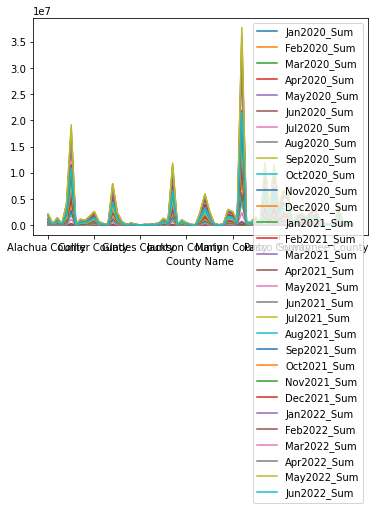

In [23]:
test = fl_month2020b.set_index("County Name").plot()

test

##### Check monthly total for March2020

In [24]:
Total = fl_month2020['Mar2020_Sum'].sum()
print (Total)

35609


##### Check all months totals 2020

In [25]:
county_month_total = fl_month2020.sum()
county_month_total

County Name    Alachua County Baker County Bay County Bradfor...
Jan2020_Sum                                                    0
Feb2020_Sum                                                    0
Mar2020_Sum                                                35609
Apr2020_Sum                                               671295
May2020_Sum                                              1394227
Jun2020_Sum                                              2634431
Jul2020_Sum                                              9735689
Aug2020_Sum                                             17445945
Sep2020_Sum                                             20066379
Oct2020_Sum                                             23221033
Nov2020_Sum                                             26762274
Dec2020_Sum                                             35853852
dtype: object

#### Plotting on graph

import matplotlib.pyplot as plt
import numpy as np

months = range(1,13)

plt.bar(months, county_month_total)
plt.xticks(months)
#yticks to sort out axis scale - 35m not 3.5
plt.ylabel('Cases')
plt.xlabel('Month')
plt.show()

#change to cell from markdown if i can get it working 
import numpy as np

plt.style.use('ggplot')

fig, ax = plt.subplots(figsize=(10, 5))

ax.barh(months, county_month_total)

plt.xticks(np.arange(0, max(county_month_total)+1, 0.1))

plt.tight_layout()

plt.show()

### Different easier ways to add row and column totals 

In [26]:
two = all_data 

two = all_data.loc[all_data["State"] =="FL"] #sorts to just FL

two = two.iloc[1: , :] #removes "Statewide Unallocated"

two = two.drop(columns=['countyFIPS', 'StateFIPS']) #drop un-needed columns

two.head()

,County Name,State,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,28/01/2020,29/01/2020,30/01/2020,31/01/2020,01/02/2020,02/02/2020,03/02/2020,04/02/2020,05/02/2020,06/02/2020,07/02/2020,08/02/2020,09/02/2020,10/02/2020,11/02/2020,12/02/2020,13/02/2020,14/02/2020,15/02/2020,16/02/2020,17/02/2020,18/02/2020,19/02/2020,20/02/2020,21/02/2020,22/02/2020,23/02/2020,24/02/2020,25/02/2020,26/02/2020,27/02/2020,28/02/2020,29/02/2020,01/03/2020,02/03/2020,03/03/2020,04/03/2020,05/03/2020,06/03/2020,07/03/2020,08/03/2020,09/03/2020,10/03/2020,11/03/2020,12/03/2020,13/03/2020,14/03/2020,15/03/2020,16/03/2020,17/03/2020,18/03/2020,19/03/2020,20/03/2020,21/03/2020,22/03/2020,23/03/2020,24/03/2020,25/03/2020,26/03/2020,27/03/2020,28/03/2020,29/03/2020,30/03/2020,31/03/2020,01/04/2020,02/04/2020,03/04/2020,04/04/2020,05/04/2020,06/04/2020,07/04/2020,08/04/2020,09/04/2020,10/04/2020,11/04/2020,12/04/2020,13/04/2020,14/04/2020,15/04/2020,16/04/2020,17/04/2020,18/04/2020,19/04/2020,20/04/2020,21/04/2020,22/04/2020,23/04/2020,24/04/2020,25/04/2020,26/04/2020,27/04/2020,28/04/2020,29/04/2020,30/04/2020,01/05/2020,02/05/2020,03/05/2020,04/05/2020,05/05/2020,06/05/2020,07/05/2020,08/05/2020,09/05/2020,10/05/2020,11/05/2020,12/05/2020,13/05/2020,14/05/2020,15/05/2020,16/05/2020,17/05/2020,18/05/2020,19/05/2020,20/05/2020,21/05/2020,22/05/2020,23/05/2020,24/05/2020,25/05/2020,26/05/2020,27/05/2020,28/05/2020,29/05/2020,30/05/2020,31/05/2020,01/06/2020,02/06/2020,03/06/2020,04/06/2020,05/06/2020,06/06/2020,07/06/2020,08/06/2020,09/06/2020,10/06/2020,11/06/2020,12/06/2020,13/06/2020,14/06/2020,15/06/2020,16/06/2020,17/06/2020,18/06/2020,19/06/2020,20/06/2020,21/06/2020,22/06/2020,23/06/2020,24/06/2020,25/06/2020,26/06/2020,27/06/2020,28/06/2020,29/06/2020,30/06/2020,01/07/2020,02/07/2020,03/07/2020,04/07/2020,05/07/2020,06/07/2020,07/07/2020,08/07/2020,09/07/2020,10/07/2020,11/07/2020,12/07/2020,13/07/2020,14/07/2020,15/07/2020,16/07/2020,17/07/2020,18/07/2020,19/07/2020,20/07/2020,21/07/2020,22/07/2020,23/07/2020,24/07/2020,25/07/2020,26/07/2020,27/07/2020,28/07/2020,29/07/2020,30/07/2020,31/07/2020,01/08/2020,02/08/2020,03/08/2020,04/08/2020,05/08/2020,06/08/2020,07/08/2020,08/08/2020,09/08/2020,10/08/2020,11/08/2020,12/08/2020,13/08/2020,14/08/2020,15/08/2020,16/08/2020,17/08/2020,18/08/2020,19/08/2020,20/08/2020,21/08/2020,22/08/2020,23/08/2020,24/08/2020,25/08/2020,26/08/2020,27/08/2020,28/08/2020,29/08/2020,30/08/2020,31/08/2020,01/09/2020,02/09/2020,03/09/2020,04/09/2020,05/09/2020,06/09/2020,07/09/2020,08/09/2020,09/09/2020,10/09/2020,11/09/2020,12/09/2020,13/09/2020,14/09/2020,15/09/2020,16/09/2020,17/09/2020,18/09/2020,19/09/2020,20/09/2020,21/09/2020,22/09/2020,23/09/2020,24/09/2020,25/09/2020,26/09/2020,27/09/2020,28/09/2020,29/09/2020,30/09/2020,01/10/2020,02/10/2020,03/10/2020,04/10/2020,05/10/2020,06/10/2020,07/10/2020,08/10/2020,09/10/2020,10/10/2020,11/10/2020,12/10/2020,13/10/2020,14/10/2020,15/10/2020,16/10/2020,17/10/2020,18/10/2020,19/10/2020,20/10/2020,21/10/2020,22/10/2020,23/10/2020,24/10/2020,25/10/2020,26/10/2020,27/10/2020,28/10/2020,29/10/2020,30/10/2020,31/10/2020,01/11/2020,02/11/2020,03/11/2020,04/11/2020,05/11/2020,06/11/2020,07/11/2020,08/11/2020,09/11/2020,10/11/2020,11/11/2020,12/11/2020,13/11/2020,14/11/2020,15/11/2020,16/11/2020,17/11/2020,18/11/2020,19/11/2020,20/11/2020,21/11/2020,22/11/2020,23/11/2020,24/11/2020,25/11/2020,26/11/2020,27/11/2020,28/11/2020,29/11/2020,30/11/2020,01/12/2020,02/12/2020,03/12/2020,04/12/2020,05/12/2020,06/12/2020,07/12/2020,08/12/2020,09/12/2020,10/12/2020,11/12/2020,12/12/2020,13/12/2020,14/12/2020,15/12/2020,16/12/2020,17/12/2020,18/12/2020,19/12/2020,20/12/2020,21/12/2020,22/12/2020,23/12/2020,24/12/2020,25/12/2020,26/12/2020,27/12/2020,28/12/2020,29/12/2020,30/12/2020,31/12/2020,01/01/2021,02/01/2021,03/01/2021,04/01/2021,05/01/2021,06/01/2021,07/01/2021,08/01/2021,09/01/2021,10/01/2021,11/01/2021,12/01/2021,13/01/2021,14/01/2021,15/01/2021,16/01/2021,17/01/2021

##### County totals for whole time period

In [27]:
two['Total'] = two.iloc[:, 2:882].sum(axis=1) #adds column 'total', adds totals on rows for each county
two.head()

#Alachua = 23,183,607

,County Name,State,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,28/01/2020,29/01/2020,30/01/2020,31/01/2020,01/02/2020,02/02/2020,03/02/2020,04/02/2020,05/02/2020,06/02/2020,07/02/2020,08/02/2020,09/02/2020,10/02/2020,11/02/2020,12/02/2020,13/02/2020,14/02/2020,15/02/2020,16/02/2020,17/02/2020,18/02/2020,19/02/2020,20/02/2020,21/02/2020,22/02/2020,23/02/2020,24/02/2020,25/02/2020,26/02/2020,27/02/2020,28/02/2020,29/02/2020,01/03/2020,02/03/2020,03/03/2020,04/03/2020,05/03/2020,06/03/2020,07/03/2020,08/03/2020,09/03/2020,10/03/2020,11/03/2020,12/03/2020,13/03/2020,14/03/2020,15/03/2020,16/03/2020,17/03/2020,18/03/2020,19/03/2020,20/03/2020,21/03/2020,22/03/2020,23/03/2020,24/03/2020,25/03/2020,26/03/2020,27/03/2020,28/03/2020,29/03/2020,30/03/2020,31/03/2020,01/04/2020,02/04/2020,03/04/2020,04/04/2020,05/04/2020,06/04/2020,07/04/2020,08/04/2020,09/04/2020,10/04/2020,11/04/2020,12/04/2020,13/04/2020,14/04/2020,15/04/2020,16/04/2020,17/04/2020,18/04/2020,19/04/2020,20/04/2020,21/04/2020,22/04/2020,23/04/2020,24/04/2020,25/04/2020,26/04/2020,27/04/2020,28/04/2020,29/04/2020,30/04/2020,01/05/2020,02/05/2020,03/05/2020,04/05/2020,05/05/2020,06/05/2020,07/05/2020,08/05/2020,09/05/2020,10/05/2020,11/05/2020,12/05/2020,13/05/2020,14/05/2020,15/05/2020,16/05/2020,17/05/2020,18/05/2020,19/05/2020,20/05/2020,21/05/2020,22/05/2020,23/05/2020,24/05/2020,25/05/2020,26/05/2020,27/05/2020,28/05/2020,29/05/2020,30/05/2020,31/05/2020,01/06/2020,02/06/2020,03/06/2020,04/06/2020,05/06/2020,06/06/2020,07/06/2020,08/06/2020,09/06/2020,10/06/2020,11/06/2020,12/06/2020,13/06/2020,14/06/2020,15/06/2020,16/06/2020,17/06/2020,18/06/2020,19/06/2020,20/06/2020,21/06/2020,22/06/2020,23/06/2020,24/06/2020,25/06/2020,26/06/2020,27/06/2020,28/06/2020,29/06/2020,30/06/2020,01/07/2020,02/07/2020,03/07/2020,04/07/2020,05/07/2020,06/07/2020,07/07/2020,08/07/2020,09/07/2020,10/07/2020,11/07/2020,12/07/2020,13/07/2020,14/07/2020,15/07/2020,16/07/2020,17/07/2020,18/07/2020,19/07/2020,20/07/2020,21/07/2020,22/07/2020,23/07/2020,24/07/2020,25/07/2020,26/07/2020,27/07/2020,28/07/2020,29/07/2020,30/07/2020,31/07/2020,01/08/2020,02/08/2020,03/08/2020,04/08/2020,05/08/2020,06/08/2020,07/08/2020,08/08/2020,09/08/2020,10/08/2020,11/08/2020,12/08/2020,13/08/2020,14/08/2020,15/08/2020,16/08/2020,17/08/2020,18/08/2020,19/08/2020,20/08/2020,21/08/2020,22/08/2020,23/08/2020,24/08/2020,25/08/2020,26/08/2020,27/08/2020,28/08/2020,29/08/2020,30/08/2020,31/08/2020,01/09/2020,02/09/2020,03/09/2020,04/09/2020,05/09/2020,06/09/2020,07/09/2020,08/09/2020,09/09/2020,10/09/2020,11/09/2020,12/09/2020,13/09/2020,14/09/2020,15/09/2020,16/09/2020,17/09/2020,18/09/2020,19/09/2020,20/09/2020,21/09/2020,22/09/2020,23/09/2020,24/09/2020,25/09/2020,26/09/2020,27/09/2020,28/09/2020,29/09/2020,30/09/2020,01/10/2020,02/10/2020,03/10/2020,04/10/2020,05/10/2020,06/10/2020,07/10/2020,08/10/2020,09/10/2020,10/10/2020,11/10/2020,12/10/2020,13/10/2020,14/10/2020,15/10/2020,16/10/2020,17/10/2020,18/10/2020,19/10/2020,20/10/2020,21/10/2020,22/10/2020,23/10/2020,24/10/2020,25/10/2020,26/10/2020,27/10/2020,28/10/2020,29/10/2020,30/10/2020,31/10/2020,01/11/2020,02/11/2020,03/11/2020,04/11/2020,05/11/2020,06/11/2020,07/11/2020,08/11/2020,09/11/2020,10/11/2020,11/11/2020,12/11/2020,13/11/2020,14/11/2020,15/11/2020,16/11/2020,17/11/2020,18/11/2020,19/11/2020,20/11/2020,21/11/2020,22/11/2020,23/11/2020,24/11/2020,25/11/2020,26/11/2020,27/11/2020,28/11/2020,29/11/2020,30/11/2020,01/12/2020,02/12/2020,03/12/2020,04/12/2020,05/12/2020,06/12/2020,07/12/2020,08/12/2020,09/12/2020,10/12/2020,11/12/2020,12/12/2020,13/12/2020,14/12/2020,15/12/2020,16/12/2020,17/12/2020,18/12/2020,19/12/2020,20/12/2020,21/12/2020,22/12/2020,23/12/2020,24/12/2020,25/12/2020,26/12/2020,27/12/2020,28/12/2020,29/12/2020,30/12/2020,31/12/2020,01/01/2021,02/01/2021,03/01/2021,04/01/2021,05/01/2021,06/01/2021,07/01/2021,08/01/2021,09/01/2021,10/01/2021,11/01/2021,12/01/2021,13/01/2021,14/01/2021,15/01/2021,16/01/2021,17/01/2021

In [28]:
len(two.columns) #checks how many columns, needed for iloc range (so it knows just to include dates and not total column)

881

In [29]:
len(fl_t1.columns)

67

In [30]:
fl_t1_monthtotal = fl_t1

In [31]:
fl_t1_monthtotal['Total'] = fl_t1_monthtotal.iloc[:, 1:68].sum(axis=1)
fl_t1_monthtotal

County Name,Alachua County,Baker County,Bay County,Bradford County,Brevard County,Broward County,Calhoun County,Charlotte County,Citrus County,Clay County,Collier County,Columbia County,DeSoto County,Dixie County,Duval County,Escambia County,Flagler County,Franklin County,Gadsden County,Gilchrist County,Glades County,Gulf County,Hamilton County,Hardee County,Hendry County,Hernando County,Highlands County,Hillsborough County,Holmes County,Indian River County,Jackson County,Jefferson County,Lafayette County,Lake County,Lee County,Leon County,Levy County,Liberty County,Madison County,Manatee County,Marion County,Martin County,Miami-Dade County,Monroe County,Nassau County,Okaloosa County,Okeechobee County,Orange County,Osceola County,Palm Beach County,Pasco County,Pinellas County,Polk County,Putnam County,St. Johns County,St. Lucie County,Santa Rosa County,Sarasota County,Seminole County,Sumter County,Suwannee County,Taylor County,Union County,Volusia County,Wakulla County,Walton County,Washington County,Total
Jan2020_Sum,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0
Feb2020_Sum,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0
Mar2020_Sum,652,60,40,13,210,7234,1,115,149,251,922,28,43,0,1086,334,93,0,14,0,7,0,0,0,10,134,76,1840,2,171,16,0,0,322,1043,152,8,0,0,363,120,156,9865,150,61,286,0,1763,652,2722,287,952,346,87,442,168,183,473,582,286,10,0,1,484,3,136,5,34957.0
Apr2020_Sum,5697,492,1323,890,5139,100862,147,3815,2156,5468,11930,945,610,85,21771,8583,2004,54,1247,91,137,30,88,156,1028,2096,1749,24501,143,2234,241,496,23,5118,20175,4156,274,41,677,9585,3130,3870,237806,1879,1131,3247,182,31092,10591,56034,5181,15620,8765,1525,5206,5008,3329,7300,8339,3749,2246,43,73,8265,372,877,178,665598.0
May2020_Sum,10272,787,2615,1524,11085,191588,1117,11250,3424,10017,30549,3467,2448,776,39693,21296,4934,62,5939,251,416,31,3406,1610,6676,3233,3205,50528,382,3322,4157,879,164,7944,45101,9247,754,5243,1979,26121,6759,11374,472942,2946,2024,5552,1248,51167,18705,138046,9943,31040,22833,4077,7146,10316,5873,15410,13453,7594,4779,226,558,18626,937,2453,708,1383955.0
Jun2020_Sum,18900,1105,5501,1794,23466,302655,2001,16885,5167,14267,82633,6079,11612,1810,82033,33889,6713,88,9471,1561,3427,309,8470,7053,20267,5365,6167,146871,1936,9338,9627,1052,492,18132,96904,16732,3325,6569,3188,49925,11252,38147,720812,4437,3216,11202,6143,132183,30814,283732,23430,90467,55812,6460,12840,29879,9815,26757,32818,8400,7574,1646,1243,33842,1174,4835,2722,2615531.0
Jul2020_Sum,74075,6255,54683,5345,117966,1100530,5685,40671,22480,55392,217451,35453,30111,4723,452826,153654,18255,1629,24248,6172,7975,4438,14572,20156,40426,31684,21818,655299,8750,44714,24822,3488,1979,92293,344332,85237,10352,8992,12368,180203,69054,90583,2368536,23077,19694,50723,19122,637841,162858,734138,135582,374260,261526,26596,67080,103255,53458,112504,147497,22648,25461,5679,4212,140861,8161,21591,8190,9661614.0
Aug2020_Sum,140131,28887,145756,17101,199982,2027982,14788,73250,53564,107006,334005,93258,43354,17147,754537,308950,35368,13062,61617,12319,13089,21148,19820,30873,57131,68306,48562,1052018,16669,81032,62852,14226,21995,172300,534460,166425,23614,12672,23509,300254,219458,122965,4403987,49252,42046,113619,34488,1024355,314178,1196320,228179,574879,470528,49423,120424,191199,128405,203877,229442,46407,60525,30730,13483,258113,23682,45600,27362,17305814.0
Sep2020_Sum,202872,40493,172265,28725,244389,2244924,17959,86934,75011,138578,368686,107412,46123,23557,862420,356019,47050,17592,78871,14766,14703,25753,23516,37339,60824,87838,60543,1197268,21318,90918,79041,16043,36670,212976,589953,271376,29407,14355,29147,330381,276607,139612,4948751,53757,58466,139185,41706,1149751,357003,1334803,260333,633745,560314,59398,147974,228765,153293,231460,259384,63453,77367,37995,24224,307488,31064,54994,31472,19863507.

##### Add total row for each individual date

In [32]:
len(two.index) #needed for iloc range - 0:67 includes all counties and not the total rows

67

In [33]:
len(fl_t1.index)

30

In [34]:
two_new = two

two_new.loc['totalDate'] = two_new.iloc[0:67, 2:882].sum() #finds totals on vertical eg date totals

two_new.tail()

#20/03/2020 = 649 total

,County Name,State,22/01/2020,23/01/2020,24/01/2020,25/01/2020,26/01/2020,27/01/2020,28/01/2020,29/01/2020,30/01/2020,31/01/2020,01/02/2020,02/02/2020,03/02/2020,04/02/2020,05/02/2020,06/02/2020,07/02/2020,08/02/2020,09/02/2020,10/02/2020,11/02/2020,12/02/2020,13/02/2020,14/02/2020,15/02/2020,16/02/2020,17/02/2020,18/02/2020,19/02/2020,20/02/2020,21/02/2020,22/02/2020,23/02/2020,24/02/2020,25/02/2020,26/02/2020,27/02/2020,28/02/2020,29/02/2020,01/03/2020,02/03/2020,03/03/2020,04/03/2020,05/03/2020,06/03/2020,07/03/2020,08/03/2020,09/03/2020,10/03/2020,11/03/2020,12/03/2020,13/03/2020,14/03/2020,15/03/2020,16/03/2020,17/03/2020,18/03/2020,19/03/2020,20/03/2020,21/03/2020,22/03/2020,23/03/2020,24/03/2020,25/03/2020,26/03/2020,27/03/2020,28/03/2020,29/03/2020,30/03/2020,31/03/2020,01/04/2020,02/04/2020,03/04/2020,04/04/2020,05/04/2020,06/04/2020,07/04/2020,08/04/2020,09/04/2020,10/04/2020,11/04/2020,12/04/2020,13/04/2020,14/04/2020,15/04/2020,16/04/2020,17/04/2020,18/04/2020,19/04/2020,20/04/2020,21/04/2020,22/04/2020,23/04/2020,24/04/2020,25/04/2020,26/04/2020,27/04/2020,28/04/2020,29/04/2020,30/04/2020,01/05/2020,02/05/2020,03/05/2020,04/05/2020,05/05/2020,06/05/2020,07/05/2020,08/05/2020,09/05/2020,10/05/2020,11/05/2020,12/05/2020,13/05/2020,14/05/2020,15/05/2020,16/05/2020,17/05/2020,18/05/2020,19/05/2020,20/05/2020,21/05/2020,22/05/2020,23/05/2020,24/05/2020,25/05/2020,26/05/2020,27/05/2020,28/05/2020,29/05/2020,30/05/2020,31/05/2020,01/06/2020,02/06/2020,03/06/2020,04/06/2020,05/06/2020,06/06/2020,07/06/2020,08/06/2020,09/06/2020,10/06/2020,11/06/2020,12/06/2020,13/06/2020,14/06/2020,15/06/2020,16/06/2020,17/06/2020,18/06/2020,19/06/2020,20/06/2020,21/06/2020,22/06/2020,23/06/2020,24/06/2020,25/06/2020,26/06/2020,27/06/2020,28/06/2020,29/06/2020,30/06/2020,01/07/2020,02/07/2020,03/07/2020,04/07/2020,05/07/2020,06/07/2020,07/07/2020,08/07/2020,09/07/2020,10/07/2020,11/07/2020,12/07/2020,13/07/2020,14/07/2020,15/07/2020,16/07/2020,17/07/2020,18/07/2020,19/07/2020,20/07/2020,21/07/2020,22/07/2020,23/07/2020,24/07/2020,25/07/2020,26/07/2020,27/07/2020,28/07/2020,29/07/2020,30/07/2020,31/07/2020,01/08/2020,02/08/2020,03/08/2020,04/08/2020,05/08/2020,06/08/2020,07/08/2020,08/08/2020,09/08/2020,10/08/2020,11/08/2020,12/08/2020,13/08/2020,14/08/2020,15/08/2020,16/08/2020,17/08/2020,18/08/2020,19/08/2020,20/08/2020,21/08/2020,22/08/2020,23/08/2020,24/08/2020,25/08/2020,26/08/2020,27/08/2020,28/08/2020,29/08/2020,30/08/2020,31/08/2020,01/09/2020,02/09/2020,03/09/2020,04/09/2020,05/09/2020,06/09/2020,07/09/2020,08/09/2020,09/09/2020,10/09/2020,11/09/2020,12/09/2020,13/09/2020,14/09/2020,15/09/2020,16/09/2020,17/09/2020,18/09/2020,19/09/2020,20/09/2020,21/09/2020,22/09/2020,23/09/2020,24/09/2020,25/09/2020,26/09/2020,27/09/2020,28/09/2020,29/09/2020,30/09/2020,01/10/2020,02/10/2020,03/10/2020,04/10/2020,05/10/2020,06/10/2020,07/10/2020,08/10/2020,09/10/2020,10/10/2020,11/10/2020,12/10/2020,13/10/2020,14/10/2020,15/10/2020,16/10/2020,17/10/2020,18/10/2020,19/10/2020,20/10/2020,21/10/2020,22/10/2020,23/10/2020,24/10/2020,25/10/2020,26/10/2020,27/10/2020,28/10/2020,29/10/2020,30/10/2020,31/10/2020,01/11/2020,02/11/2020,03/11/2020,04/11/2020,05/11/2020,06/11/2020,07/11/2020,08/11/2020,09/11/2020,10/11/2020,11/11/2020,12/11/2020,13/11/2020,14/11/2020,15/11/2020,16/11/2020,17/11/2020,18/11/2020,19/11/2020,20/11/2020,21/11/2020,22/11/2020,23/11/2020,24/11/2020,25/11/2020,26/11/2020,27/11/2020,28/11/2020,29/11/2020,30/11/2020,01/12/2020,02/12/2020,03/12/2020,04/12/2020,05/12/2020,06/12/2020,07/12/2020,08/12/2020,09/12/2020,10/12/2020,11/12/2020,12/12/2020,13/12/2020,14/12/2020,15/12/2020,16/12/2020,17/12/2020,18/12/2020,19/12/2020,20/12/2020,21/12/2020,22/12/2020,23/12/2020,24/12/2020,25/12/2020,26/12/2020,27/12/2020,28/12/2020,29/12/2020,30/12/2020,31/12/2020,01/01/2021,02/01/2021,03/01/2021,04/01/2021,05/01/2021,06/01/2021,07/01/2021,08/01/2021,09/01/2021,10/01/2021,11/01/2021,12/01/2021,13/01/2021,14/01/2021,15/01/2021,16/01/2021,17/01/2021

In [35]:
fl_t1_countytotal = fl_t1

fl_t1_countytotal.loc['totalDate'] = fl_t1_countytotal.iloc[0:30, 0:67].sum() #finds totals on vertical eg date totals

fl_t1_countytotal

County Name,Alachua County,Baker County,Bay County,Bradford County,Brevard County,Broward County,Calhoun County,Charlotte County,Citrus County,Clay County,Collier County,Columbia County,DeSoto County,Dixie County,Duval County,Escambia County,Flagler County,Franklin County,Gadsden County,Gilchrist County,Glades County,Gulf County,Hamilton County,Hardee County,Hendry County,Hernando County,Highlands County,Hillsborough County,Holmes County,Indian River County,Jackson County,Jefferson County,Lafayette County,Lake County,Lee County,Leon County,Levy County,Liberty County,Madison County,Manatee County,Marion County,Martin County,Miami-Dade County,Monroe County,Nassau County,Okaloosa County,Okeechobee County,Orange County,Osceola County,Palm Beach County,Pasco County,Pinellas County,Polk County,Putnam County,St. Johns County,St. Lucie County,Santa Rosa County,Sarasota County,Seminole County,Sumter County,Suwannee County,Taylor County,Union County,Volusia County,Wakulla County,Walton County,Washington County,Total
Jan2020_Sum,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0
Feb2020_Sum,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0
Mar2020_Sum,652,60,40,13,210,7234,1,115,149,251,922,28,43,0,1086,334,93,0,14,0,7,0,0,0,10,134,76,1840,2,171,16,0,0,322,1043,152,8,0,0,363,120,156,9865,150,61,286,0,1763,652,2722,287,952,346,87,442,168,183,473,582,286,10,0,1,484,3,136,5,34957.0
Apr2020_Sum,5697,492,1323,890,5139,100862,147,3815,2156,5468,11930,945,610,85,21771,8583,2004,54,1247,91,137,30,88,156,1028,2096,1749,24501,143,2234,241,496,23,5118,20175,4156,274,41,677,9585,3130,3870,237806,1879,1131,3247,182,31092,10591,56034,5181,15620,8765,1525,5206,5008,3329,7300,8339,3749,2246,43,73,8265,372,877,178,665598.0
May2020_Sum,10272,787,2615,1524,11085,191588,1117,11250,3424,10017,30549,3467,2448,776,39693,21296,4934,62,5939,251,416,31,3406,1610,6676,3233,3205,50528,382,3322,4157,879,164,7944,45101,9247,754,5243,1979,26121,6759,11374,472942,2946,2024,5552,1248,51167,18705,138046,9943,31040,22833,4077,7146,10316,5873,15410,13453,7594,4779,226,558,18626,937,2453,708,1383955.0
Jun2020_Sum,18900,1105,5501,1794,23466,302655,2001,16885,5167,14267,82633,6079,11612,1810,82033,33889,6713,88,9471,1561,3427,309,8470,7053,20267,5365,6167,146871,1936,9338,9627,1052,492,18132,96904,16732,3325,6569,3188,49925,11252,38147,720812,4437,3216,11202,6143,132183,30814,283732,23430,90467,55812,6460,12840,29879,9815,26757,32818,8400,7574,1646,1243,33842,1174,4835,2722,2615531.0
Jul2020_Sum,74075,6255,54683,5345,117966,1100530,5685,40671,22480,55392,217451,35453,30111,4723,452826,153654,18255,1629,24248,6172,7975,4438,14572,20156,40426,31684,21818,655299,8750,44714,24822,3488,1979,92293,344332,85237,10352,8992,12368,180203,69054,90583,2368536,23077,19694,50723,19122,637841,162858,734138,135582,374260,261526,26596,67080,103255,53458,112504,147497,22648,25461,5679,4212,140861,8161,21591,8190,9661614.0
Aug2020_Sum,140131,28887,145756,17101,199982,2027982,14788,73250,53564,107006,334005,93258,43354,17147,754537,308950,35368,13062,61617,12319,13089,21148,19820,30873,57131,68306,48562,1052018,16669,81032,62852,14226,21995,172300,534460,166425,23614,12672,23509,300254,219458,122965,4403987,49252,42046,113619,34488,1024355,314178,1196320,228179,574879,470528,49423,120424,191199,128405,203877,229442,46407,60525,30730,13483,258113,23682,45600,27362,17305814.0
Sep2020_Sum,202872,40493,172265,28725,244389,2244924,17959,86934,75011,138578,368686,107412,46123,23557,862420,356019,47050,17592,78871,14766,14703,25753,23516,37339,60824,87838,60543,1197268,21318,90918,79041,16043,36670,212976,589953,271376,29407,14355,29147,330381,276607,139612,4948751,53757,58466,139185,41706,1149751,357003,1334803,260333,633745,560314,59398,147974,228765,153293,231460,259384,63453,77367,37995,24224,307488,31064,54994,31472,19863507.

### Natural Disaster data

In [36]:
disasters = pd.read_csv("DisasterDeclarationsSummaries.csv")
disasters.head()

,femaDeclarationString,disasterNumber,state,declarationType,declarationDate,fyDeclared,incidentType,declarationTitle,ihProgramDeclared,iaProgramDeclared,paProgramDeclared,hmProgramDeclared,incidentBeginDate,incidentEndDate,disasterCloseoutDate,fipsStateCode,fipsCountyCode,placeCode,designatedArea,declarationRequestNumber,lastIAFilingDate,hash,lastRefresh,id
0,DR-7-MA,7,MA,DR,1953-06-11T00:00:00.000Z,1953,Tornado,TORNADO,0,1,1,1,1953-06-11T00:00:00.000Z,1953-06-11T00:00:00.000Z,1956-06-01T00:00:00.000Z,25,0,0,Statewide,53009,NaN,ef38e5621e22ab18f9de34186cfaef6952a79466,2022-04-26T19:03:06.751Z,60c3b7a9a0ee349d71025720
1,DR-6-MI,6,MI,DR,1953-06-09T00:00:00.000Z,1953,Tornado,TORNADO,0,1,1,1,1953-06-09T00:00:00.000Z,1953-06-09T00:00:00.000Z,1956-03-30T00:00:00.000Z,26,0,0,Statewide,53007,NaN,d38e4a167cc37c4e465bd7f6a6973b52f6c97ed8,2022-04-26T19:03:06.753Z,60c3b7a9a0ee349d71025766
2,DR-2-TX,2,TX,DR,1953-05-15T00:00:00.000Z,1953,Tornado,TORNADO & HEAVY RAINFALL,0,1,1,1,1953-05-15T00:00:00.000Z,1953-05-15T00:00:00.000Z,1958-01-01T00:00:00.000Z,48,0,0,Statewide,53003,NaN,8784655a1395087b17c39b9f7422a5fd1db7826d,2022-04-26T19:03:06.760Z,60c3b7a9a0ee349d71025783
3,DR-4-MI,4,MI,DR,1953-06-02T00:00:00.000Z,1953,Tornado,TORNADO,0,1,1,1,1953-06-02T00:00:00.000Z,1953-06-02T00:00:00.000Z,1956-02-01T00:00:00.000Z,26,0,0,Statewide,53004,NaN,53ea4b01cfae0448d980cc14d4487b78f95f80ad,2022-04-26T19:03:06.757Z,60c3b7a9a0ee349d7102577a
4,DR-1-GA,1,GA,DR,1953-05-02T00:00:00.000Z,1953,Tornado,TORNADO,0,1,1,1,1953-05-02T00:00:00.000Z,1953-05-02T00:00:00.000Z,1954-06-01T00:00:00.000Z,13,0,0,Statewide,53013,NaN,d79586ee70f2ea4bc33a5b3ea900902fda5131c1,2022-04-26T19:03:06.761Z,60c3b7a9a0ee349d71025780


##### Creates new column 'year' 

In [37]:
disasters['Year'] = disasters['declarationDate'].str[0:4] # Creates new column 'year' from 'declarationDate', 
        #then fills 'year' with first 4 (.str[0:4]) values from decDate (eg 2020)

disasters['Year'] = disasters['Year'].astype('int32') # Then converts from string to numeric int32 with .astype

disasters.tail() # (fyDeclared not used as year sometimes differs to actual start time of disaster)

,femaDeclarationString,disasterNumber,state,declarationType,declarationDate,fyDeclared,incidentType,declarationTitle,ihProgramDeclared,iaProgramDeclared,paProgramDeclared,hmProgramDeclared,incidentBeginDate,incidentEndDate,disasterCloseoutDate,fipsStateCode,fipsCountyCode,placeCode,designatedArea,declarationRequestNumber,lastIAFilingDate,hash,lastRefresh,id,Year
63027,DR-4654-KS,4654,KS,DR,2022-05-25T14:51:00.000Z,2022,Snow,SEVERE WINTER STORMS AND STRAIGHT-LINE WINDS,0,0,1,1,2022-03-17T00:00:00.000Z,2022-03-22T00:00:00.000Z,NaN,20,199,99199,Wallace (County),22039,NaN,d5bcfee9515159623b38d4ae4046993bfaf31df1,2022-05-25T20:02:07.212Z,628e8b3f8311f76a9a55d947,2022
63028,FM-5441-AZ,5441,AZ,FM,2022-06-12T20:39:00.000Z,2022,Fire,PIPELINE FIRE,0,0,1,1,2022-06-12T10:15:00.000Z,NaN,NaN,4,5,99005,Coconino (County),22047,NaN,38531f0d119bcf5622f4932ebd2cd1e9bbcf8bd8,2022-06-13T17:22:08.773Z,62a77240c7a2217896a07138,2022
63029,DR-4655-MT,4655,MT,DR,2022-06-16T08:00:00.000Z,2022,Flood,SEVERE STORM AND FLOODING,0,0,1,1,2022-06-10T01:00:00.000Z,NaN,NaN,30,67,99067,Park (County),22050,NaN,7f2fc6bf0e2fa3b9977344caac0afbac9d92558a,2022-06-16T16:22:04.821Z,62ab58acc7a2217896493df7,2022
63030,DR-4655-MT,4655,MT,DR,2022-06-16T08:00:00.000Z,2022,Flood,SEVERE STORM AND FLOODING,0,0,1,1,2022-06-10T01:00:00.000Z,NaN,NaN,30,9,99009,Carbon (County),22050,NaN,3744406910261a232b37b500de2e7fd2c27897dd,2022-06-16T16:22:04.820Z,62ab58acc7a2217896493df5,2022
63031,DR-4655-MT,4655,MT,DR,2022-06-16T08:00:00.000Z,2022,Flood,SEVERE STORM AND FLOODING,0,0,1,1,2022-06-10T01:00:00.000Z,NaN,NaN,30,95,99095,Stillwater (County),22050,NaN,144cbcf9cc2c84560a3643fa71d071e5e0be30fa,2022-06-16T16:22:04.821Z,62ab58acc7a2217896493df9,2022


In [38]:
disasters.info() # check data type for each column

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63032 entries, 0 to 63031
Data columns (total 25 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   femaDeclarationString     63032 non-null  object
 1   disasterNumber            63032 non-null  int64 
 2   state                     63032 non-null  object
 3   declarationType           63032 non-null  object
 4   declarationDate           63032 non-null  object
 5   fyDeclared                63032 non-null  int64 
 6   incidentType              63032 non-null  object
 7   declarationTitle          63032 non-null  object
 8   ihProgramDeclared         63032 non-null  int64 
 9   iaProgramDeclared         63032 non-null  int64 
 10  paProgramDeclared         63032 non-null  int64 
 11  hmProgramDeclared         63032 non-null  int64 
 12  incidentBeginDate         63032 non-null  object
 13  incidentEndDate           54673 non-null  object
 14  disasterCloseoutDate  

##### Creates new df with COVID-19 removed as a natural disaster

In [39]:
dis_df = disasters[disasters["declarationTitle"].str.contains("COVID-19")==False]

dis_df.head()

,femaDeclarationString,disasterNumber,state,declarationType,declarationDate,fyDeclared,incidentType,declarationTitle,ihProgramDeclared,iaProgramDeclared,paProgramDeclared,hmProgramDeclared,incidentBeginDate,incidentEndDate,disasterCloseoutDate,fipsStateCode,fipsCountyCode,placeCode,designatedArea,declarationRequestNumber,lastIAFilingDate,hash,lastRefresh,id,Year
0,DR-7-MA,7,MA,DR,1953-06-11T00:00:00.000Z,1953,Tornado,TORNADO,0,1,1,1,1953-06-11T00:00:00.000Z,1953-06-11T00:00:00.000Z,1956-06-01T00:00:00.000Z,25,0,0,Statewide,53009,NaN,ef38e5621e22ab18f9de34186cfaef6952a79466,2022-04-26T19:03:06.751Z,60c3b7a9a0ee349d71025720,1953
1,DR-6-MI,6,MI,DR,1953-06-09T00:00:00.000Z,1953,Tornado,TORNADO,0,1,1,1,1953-06-09T00:00:00.000Z,1953-06-09T00:00:00.000Z,1956-03-30T00:00:00.000Z,26,0,0,Statewide,53007,NaN,d38e4a167cc37c4e465bd7f6a6973b52f6c97ed8,2022-04-26T19:03:06.753Z,60c3b7a9a0ee349d71025766,1953
2,DR-2-TX,2,TX,DR,1953-05-15T00:00:00.000Z,1953,Tornado,TORNADO & HEAVY RAINFALL,0,1,1,1,1953-05-15T00:00:00.000Z,1953-05-15T00:00:00.000Z,1958-01-01T00:00:00.000Z,48,0,0,Statewide,53003,NaN,8784655a1395087b17c39b9f7422a5fd1db7826d,2022-04-26T19:03:06.760Z,60c3b7a9a0ee349d71025783,1953
3,DR-4-MI,4,MI,DR,1953-06-02T00:00:00.000Z,1953,Tornado,TORNADO,0,1,1,1,1953-06-02T00:00:00.000Z,1953-06-02T00:00:00.000Z,1956-02-01T00:00:00.000Z,26,0,0,Statewide,53004,NaN,53ea4b01cfae0448d980cc14d4487b78f95f80ad,2022-04-26T19:03:06.757Z,60c3b7a9a0ee349d7102577a,1953
4,DR-1-GA,1,GA,DR,1953-05-02T00:00:00.000Z,1953,Tornado,TORNADO,0,1,1,1,1953-05-02T00:00:00.000Z,1953-05-02T00:00:00.000Z,1954-06-01T00:00:00.000Z,13,0,0,Statewide,53013,NaN,d79586ee70f2ea4bc33a5b3ea900902fda5131c1,2022-04-26T19:03:06.761Z,60c3b7a9a0ee349d71025780,1953


##### Update dis_df to only show natural disasters in FL after 2019 (start of COVID ~Jan2020 in USA) 

In [40]:
dis_df = dis_df.loc[(dis_df['state'] == "FL") & (dis_df['Year'] > 2019)]
dis_df.drop(['id', 'lastRefresh', 'hash', 'lastIAFilingDate', 'declarationRequestNumber', 'placeCode', 'fipsCountyCode', 'fipsStateCode', 'disasterCloseoutDate', 'fyDeclared'], axis=1, inplace=True)
column_to_move = dis_df.pop("Year")
dis_df.insert(4, "Year", column_to_move)
dis_df

,femaDeclarationString,disasterNumber,state,declarationType,Year,declarationDate,incidentType,declarationTitle,ihProgramDeclared,iaProgramDeclared,paProgramDeclared,hmProgramDeclared,incidentBeginDate,incidentEndDate,designatedArea
47467,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Brevard (County)
47468,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Broward (County)
47469,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Clay (County)
47470,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Duval (County)
47471,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Flagler (County)
47472,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Indian River (County)
47473,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Martin (County)
47474,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Miami-Dade (County)
47475,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,Orange (County)
47476,EM-3533-FL,3533,FL,EM,2020,2020-08-01T08:10:00.000Z,Hurricane,HURRICANE ISAIAS,0,0,1,0,2020-07-31T21:46:00.000Z,2020-08-04T23:59:00.000Z,St. Lucie (County)


In [41]:
import plotly
import plotly.express as px

In [42]:
fig = px.line(fl_t1)
fig.show()

ValueError: Plotly Express cannot process wide-form data with columns of different type.

In [43]:
fl_t1_monthtotal.dtypes

County Name
Alachua County           object
Baker County             object
Bay County               object
Bradford County          object
Brevard County           object
Broward County           object
Calhoun County           object
Charlotte County         object
Citrus County            object
Clay County              object
Collier County           object
Columbia County          object
DeSoto County            object
Dixie County             object
Duval County             object
Escambia County          object
Flagler County           object
Franklin County          object
Gadsden County           object
Gilchrist County         object
Glades County            object
Gulf County              object
Hamilton County          object
Hardee County            object
Hendry County            object
Hernando County          object
Highlands County         object
Hillsborough County      object
Holmes County            object
Indian River County      object
Jackson County           obj

In [44]:
#fig2 = px.line(fl_t1_monthtotal) #find solution - object instead of float64? 
#fig2.show()

In [45]:
#next time:
    #git - version control setup 
    #try tidy up fl_t1 fig - maybe order legend by highest values ? 
    #add 2021 and 2022 totals - DONE

In [46]:
#fl_t1.to_csv('FL_allmonths.csv') #converts to csv

#### Geodata for counties

In [47]:
county_data = pd.read_csv('uscounty1.csv', sep=";")
pd.set_option("display.max_rows", None, "display.max_columns", None)

In [48]:
county_data.sort_values('NAMELSAD')

,Geo Point,Geo Shape,STATEFP,COUNTYFP,COUNTYNS,GEOID,NAME,NAMELSAD,STUSAB,LSAD,CLASSFP,MTFCC,CSAFP,CBSAFP,METDIVFP,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,STATE_NAME,COUNTYFP NOZERO
22,"29.6747549911,-82.3577015483","{""coordinates"": [[[-82.657043, 29.726635], [-8...",12,1,308548,12001,Alachua,Alachua County,FL,6,H1,G4020,264.0,23540.0,NaN,A,2267634813,241567998,29.675740,-82.357221,Florida,1
58,"30.331070985,-82.2845872684","{""coordinates"": [[[-82.101075, 30.362791], [-8...",12,3,306920,12003,Baker,Baker County,FL,6,H1,G4020,300.0,27260.0,NaN,A,1515738968,9686120,30.324442,-82.302284,Florida,3
56,"30.237646533,-85.6326228076","{""coordinates"": [[[-85.995651, 30.281311], [-8...",12,5,295738,12005,Bay,Bay County,FL,6,H1,G4020,NaN,37460.0,NaN,A,1964743641,711110042,30.238218,-85.631680,Florida,5
19,"29.9499595746,-82.1687777662","{""coordinates"": [[[-82.273999, 29.998323], [-8...",12,7,303634,12007,Bradford,Bradford County,FL,6,H1,G4020,NaN,NaN,NaN,A,761362115,16905201,29.952386,-82.166679,Florida,7
34,"28.300314142,-80.7012054832","{""coordinates"": [[[-80.861576, 28.246558], [-8...",12,9,295749,12009,Brevard,Brevard County,FL,6,H1,G4020,NaN,37340.0,NaN,A,2628793422,1403880653,28.298311,-80.700333,Florida,9
8,"26.1518560378,-80.4558842537","{""coordinates"": [[[-80.296986, 26.334356], [-8...",12,11,295753,12011,Broward,Broward County,FL,6,H1,G4020,370.0,33100.0,22744.0,A,3115289087,310801098,26.193535,-80.476683,Florida,11
9,"30.4060343343,-85.1972071433","{""coordinates"": [[[-85.171891, 30.564336], [-8...",12,13,306919,12013,Calhoun,Calhoun County,FL,6,H1,G4020,NaN,NaN,NaN,A,1469394565,18070425,30.388801,-85.197915,Florida,13
51,"26.8998432654,-81.9503159678","{""coordinates"": [[[-82.255297, 27.000336], [-8...",12,15,295742,12015,Charlotte,Charlotte County,FL,6,H1,G4020,412.0,39460.0,NaN,A,1764058559,458736680,26.868975,-81.941278,Florida,15
1,"28.8475696914,-82.5201067311","{""coordinates"": [[[-82.451416, 28.694813], [-8...",12,17,295752,12017,Citrus,Citrus County,FL,6,H1,G4020,NaN,26140.0,NaN,A,1507142302,495547944,28.843640,-82.524810,Florida,17
66,"29.9830664456,-81.8578845259","{""coordinates"": [[[-81.798227, 30.188998], [-8...",12,19,295726,12019,Clay,Clay County,FL,6,H1,G4020,300.0,27260.0,NaN,A,1565946418,100824283,29.986583,-81.865036,Florida,19


In [49]:
county_data['Geo Shape'] = county_data['Geo Shape'].map(lambda x: x.lstrip('{"coordinates":'))

In [50]:
#county_data.to_csv('countycarto.csv')

In [51]:
with pd.option_context('display.max_colwidth', None):
  display(county_data['Geo Shape'])

0                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                       

In [52]:
import geopandas as gpd #used for geojsons

In [53]:
county_gjson = gpd.read_file('uscountynew.geojson')

In [54]:
county_gjson

,intptlat,countyns,countyfp_nozero,stusab,state_name,csafp,aland,geoid,countyfp,namelsad,awater,classfp,lsad,funcstat,name,metdivfp,cbsafp,intptlon,statefp,mtfcc,geometry
0,+26.6491257,00295761,99,FL,Florida,370,5087468869,12099,099,Palm Beach County,1084901519,H1,06,A,Palm Beach,48424,33100,-080.4483542,12,G4020,"POLYGON ((-80.48240 26.95795, -80.45853 26.957..."
1,+28.8436402,00295752,17,FL,Florida,None,1507142302,12017,017,Citrus County,495547944,H1,06,A,Citrus,None,26140,-082.5248099,12,G4020,"POLYGON ((-82.45142 28.69481, -82.45247 28.694..."
2,+29.8101756,00306911,37,FL,Florida,None,1411908392,12037,037,Franklin County,1275539662,H1,06,A,Franklin,None,None,-084.7991742,12,G4020,"POLYGON ((-84.76098 30.01149, -84.76090 30.011..."
3,+29.5808994,00295725,29,FL,Florida,None,1826222177,12029,029,Dixie County,410621177,H1,06,A,Dixie,None,None,-083.1956656,12,G4020,"MULTIPOLYGON (((-83.32401 29.77460, -83.32370 ..."
4,+30.6116382,00295737,33,FL,Florida,426,1701552902,12033,033,Escambia County,563919214,H1,06,A,Escambia,None,37860,-087.3388996,12,G4020,"POLYGON ((-87.44034 30.69035, -87.44038 30.690..."
5,+27.9066072,00295757,57,FL,Florida,None,2646772012,12057,057,Hillsborough County,631505816,H1,06,A,Hillsborough,None,45300,-082.3497186,12,G4020,"POLYGON ((-82.56582 27.81760, -82.56612 27.823..."
6,+28.5143906,00295750,95,FL,Florida,422,2335820971,12095,095,Orange County,262462219,H1,06,A,Orange,None,36740,-081.3232839,12,G4020,"POLYGON ((-81.65739 28.55312, -81.65739 28.553..."
7,+29.2028047,00306922,83,FL,Florida,None,4113978836,12083,083,Marion County,192297049,H1,06,A,Marion,None,36100,-082.0431004,12,G4020,"POLYGON ((-82.40459 29.27886, -82.40472 29.286..."
8,+26.1935353,00295753,11,FL,Florida,370,3115289087,12011,011,Broward County,310801098,H1,06,A,Broward,22744,33100,-080.4766834,12,G4020,"POLYGON ((-80.29699 26.33436, -80.29693 26.334..."
9,+30.3888013,00306919,13,FL,Florida,None,1469394565,12013,013,Calhoun County,18070425,H1,06,A,Calhoun,None,None,-085.1979155,12,G4020,"POLYGON ((-85.17189 30.56434, -85.17191 30.564..."


In [55]:
grouped_gj = county_gjson.sort_values('namelsad')
grouped_gj.reset_index(drop=True, inplace=True) #reset index to 0 
grouped_gj.rename(columns={'namelsad': 'County Name'}, inplace=True)
grouped_gj

,intptlat,countyns,countyfp_nozero,stusab,state_name,csafp,aland,geoid,countyfp,County Name,awater,classfp,lsad,funcstat,name,metdivfp,cbsafp,intptlon,statefp,mtfcc,geometry
0,+29.6757403,00308548,1,FL,Florida,264,2267634813,12001,001,Alachua County,241567998,H1,06,A,Alachua,None,23540,-082.3572210,12,G4020,"POLYGON ((-82.65704 29.72664, -82.65703 29.726..."
1,+30.3244416,00306920,3,FL,Florida,300,1515738968,12003,003,Baker County,9686120,H1,06,A,Baker,None,27260,-082.3022838,12,G4020,"POLYGON ((-82.10107 30.36279, -82.10101 30.362..."
2,+30.2382176,00295738,5,FL,Florida,None,1964743641,12005,005,Bay County,711110042,H1,06,A,Bay,None,37460,-085.6316798,12,G4020,"POLYGON ((-85.99565 30.28131, -85.99562 30.282..."
3,+29.9523863,00303634,7,FL,Florida,None,761362115,12007,007,Bradford County,16905201,H1,06,A,Bradford,None,None,-082.1666793,12,G4020,"POLYGON ((-82.27400 29.99832, -82.27398 29.998..."
4,+28.2983112,00295749,9,FL,Florida,None,2628793422,12009,009,Brevard County,1403880653,H1,06,A,Brevard,None,37340,-080.7003334,12,G4020,"POLYGON ((-80.86158 28.24656, -80.86155 28.247..."
5,+26.1935353,00295753,11,FL,Florida,370,3115289087,12011,011,Broward County,310801098,H1,06,A,Broward,22744,33100,-080.4766834,12,G4020,"POLYGON ((-80.29699 26.33436, -80.29693 26.334..."
6,+30.3888013,00306919,13,FL,Florida,None,1469394565,12013,013,Calhoun County,18070425,H1,06,A,Calhoun,None,None,-085.1979155,12,G4020,"POLYGON ((-85.17189 30.56434, -85.17191 30.564..."
7,+26.8689745,00295742,15,FL,Florida,412,1764058559,12015,015,Charlotte County,458736680,H1,06,A,Charlotte,None,39460,-081.9412782,12,G4020,"POLYGON ((-82.25530 27.00034, -82.25530 27.000..."
8,+28.8436402,00295752,17,FL,Florida,None,1507142302,12017,017,Citrus County,495547944,H1,06,A,Citrus,None,26140,-082.5248099,12,G4020,"POLYGON ((-82.45142 28.69481, -82.45247 28.694..."
9,+29.9865835,00295726,19,FL,Florida,300,1565946418,12019,019,Clay County,100824283,H1,06,A,Clay,None,27260,-081.8650364,12,G4020,"POLYGON ((-81.79823 30.18900, -81.79273 30.189..."


In [56]:
grouped_gj.to_csv('cartolocation.csv')

In [57]:
grouped_gj.drop(grouped_gj.columns.difference(['County Name','geometry']), 1, inplace=True)
grouped_gj.head()

C:\Users\jakea\AppData\Local\Temp\ipykernel_1912\2922497601.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  grouped_gj.drop(grouped_gj.columns.difference(['County Name','geometry']), 1, inplace=True)


,County Name,geometry
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726..."
1,Baker County,"POLYGON ((-82.10107 30.36279, -82.10101 30.362..."
2,Bay County,"POLYGON ((-85.99565 30.28131, -85.99562 30.282..."
3,Bradford County,"POLYGON ((-82.27400 29.99832, -82.27398 29.998..."
4,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247..."


In [89]:
grouped_gj.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 67 entries, 0 to 66
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   County Name  67 non-null     object  
 1   geometry     67 non-null     geometry
dtypes: geometry(1), object(1)
memory usage: 1.2+ KB


In [59]:
fl_month2020b

,County Name,Jan2020_Sum,Feb2020_Sum,Mar2020_Sum,Apr2020_Sum,May2020_Sum,Jun2020_Sum,Jul2020_Sum,Aug2020_Sum,Sep2020_Sum,Oct2020_Sum,Nov2020_Sum,Dec2020_Sum,Jan2021_Sum,Feb2021_Sum,Mar2021_Sum,Apr2021_Sum,May2021_Sum,Jun2021_Sum,Jul2021_Sum,Aug2021_Sum,Sep2021_Sum,Oct2021_Sum,Nov2021_Sum,Dec2021_Sum,Jan2022_Sum,Feb2022_Sum,Mar2022_Sum,Apr2022_Sum,May2022_Sum,Jun2022_Sum
0,Alachua County,0,0,652,5697,10272,18900,74075,140131,202872,290024,353769,445187,572062,608457,709065,721548,777701,762210,812689,954470,1101442,1210471,1193842,1258827,1622418,1834135,2094176,2045463,2148291,1214761
1,Baker County,0,0,60,492,787,1105,6255,28887,40493,51374,57339,69560,86355,89774,103174,102613,108982,107081,121655,150984,172178,184546,179785,187006,212376,235856,267820,260284,270321,149382
2,Bay County,0,0,40,1323,2615,5501,54683,145756,172265,199748,230240,315397,437472,500460,595719,591102,630995,603887,656049,810344,904305,977432,955973,996066,1147753,1247116,1412066,1371171,1426408,794124
3,Bradford County,0,0,13,890,1524,1794,5345,17101,28725,36921,39598,53747,76191,77552,89559,88574,93867,91551,102909,128133,151470,164623,160229,166408,187903,203711,231160,224488,233983,129825
4,Brevard County,0,0,210,5139,11085,23466,117966,199982,244389,319679,410162,568114,791573,895228,1106864,1172335,1306270,1287756,1435048,1857842,2261298,2479186,2433184,2562204,3272755,3612696,4110229,4007530,4229505,2408525
5,Broward County,0,0,7234,100862,191588,302655,1100530,2027982,2244924,2509368,2886905,3812073,4856488,5172096,6355142,6785501,7487524,7347065,7890186,9146831,10126807,10953618,10761265,11545479,16062790,16468078,18528010,18089694,19165101,10932409
6,Calhoun County,0,0,1,147,1117,2001,5685,14788,17959,20696,23982,32042,43981,44207,50806,50168,52636,51358,56569,71266,84627,92784,90265,93630,105042,111945,126432,122706,127431,70471
7,Charlotte County,0,0,115,3815,11250,16885,40671,73250,86934,103828,130848,193725,272340,287509,343392,366323,406173,401525,428858,508142,629823,709655,701764,739906,873544,953281,1098975,1076853,1137778,646117
8,Citrus County,0,0,149,2156,3424,5167,22480,53564,75011,93502,119155,177646,241283,260379,311436,319462,347789,342977,368634,451376,559405,626651,615332,645821,734395,796728,911179,887175,933240,526834
9,Clay County,0,0,251,5468,10017,14267,55392,107006,138578,175202,210331,296231,424169,453428,528408,536078,585861,583017,657593,824101,945040,1039978,1017527,1064671,1294367,1456274,1655774,1605103,1672074,937237


##### attempts to join csv and geojson

In [60]:
fl_month2020b.merge(grouped_gj[['geometry', 'County Name']], on = 'County Name', how = 'left')

,County Name,Jan2020_Sum,Feb2020_Sum,Mar2020_Sum,Apr2020_Sum,May2020_Sum,Jun2020_Sum,Jul2020_Sum,Aug2020_Sum,Sep2020_Sum,Oct2020_Sum,Nov2020_Sum,Dec2020_Sum,Jan2021_Sum,Feb2021_Sum,Mar2021_Sum,Apr2021_Sum,May2021_Sum,Jun2021_Sum,Jul2021_Sum,Aug2021_Sum,Sep2021_Sum,Oct2021_Sum,Nov2021_Sum,Dec2021_Sum,Jan2022_Sum,Feb2022_Sum,Mar2022_Sum,Apr2022_Sum,May2022_Sum,Jun2022_Sum,geometry
0,Alachua County,0,0,652,5697,10272,18900,74075,140131,202872,290024,353769,445187,572062,608457,709065,721548,777701,762210,812689,954470,1101442,1210471,1193842,1258827,1622418,1834135,2094176,2045463,2148291,1214761,None
1,Baker County,0,0,60,492,787,1105,6255,28887,40493,51374,57339,69560,86355,89774,103174,102613,108982,107081,121655,150984,172178,184546,179785,187006,212376,235856,267820,260284,270321,149382,None
2,Bay County,0,0,40,1323,2615,5501,54683,145756,172265,199748,230240,315397,437472,500460,595719,591102,630995,603887,656049,810344,904305,977432,955973,996066,1147753,1247116,1412066,1371171,1426408,794124,None
3,Bradford County,0,0,13,890,1524,1794,5345,17101,28725,36921,39598,53747,76191,77552,89559,88574,93867,91551,102909,128133,151470,164623,160229,166408,187903,203711,231160,224488,233983,129825,None
4,Brevard County,0,0,210,5139,11085,23466,117966,199982,244389,319679,410162,568114,791573,895228,1106864,1172335,1306270,1287756,1435048,1857842,2261298,2479186,2433184,2562204,3272755,3612696,4110229,4007530,4229505,2408525,None
5,Broward County,0,0,7234,100862,191588,302655,1100530,2027982,2244924,2509368,2886905,3812073,4856488,5172096,6355142,6785501,7487524,7347065,7890186,9146831,10126807,10953618,10761265,11545479,16062790,16468078,18528010,18089694,19165101,10932409,None
6,Calhoun County,0,0,1,147,1117,2001,5685,14788,17959,20696,23982,32042,43981,44207,50806,50168,52636,51358,56569,71266,84627,92784,90265,93630,105042,111945,126432,122706,127431,70471,None
7,Charlotte County,0,0,115,3815,11250,16885,40671,73250,86934,103828,130848,193725,272340,287509,343392,366323,406173,401525,428858,508142,629823,709655,701764,739906,873544,953281,1098975,1076853,1137778,646117,None
8,Citrus County,0,0,149,2156,3424,5167,22480,53564,75011,93502,119155,177646,241283,260379,311436,319462,347789,342977,368634,451376,559405,626651,615332,645821,734395,796728,911179,887175,933240,526834,None
9,Clay County,0,0,251,5468,10017,14267,55392,107006,138578,175202,210331,296231,424169,453428,528408,536078,585861,583017,657593,824101,945040,1039978,1017527,1064671,1294367,1456274,1655774,1605103,1672074,937237,None


In [61]:
merged = gpd.GeoDataFrame(pd.merge(fl_month2020b, grouped_gj, on="County Name", how="left"))
merged

,County Name,Jan2020_Sum,Feb2020_Sum,Mar2020_Sum,Apr2020_Sum,May2020_Sum,Jun2020_Sum,Jul2020_Sum,Aug2020_Sum,Sep2020_Sum,Oct2020_Sum,Nov2020_Sum,Dec2020_Sum,Jan2021_Sum,Feb2021_Sum,Mar2021_Sum,Apr2021_Sum,May2021_Sum,Jun2021_Sum,Jul2021_Sum,Aug2021_Sum,Sep2021_Sum,Oct2021_Sum,Nov2021_Sum,Dec2021_Sum,Jan2022_Sum,Feb2022_Sum,Mar2022_Sum,Apr2022_Sum,May2022_Sum,Jun2022_Sum,geometry
0,Alachua County,0,0,652,5697,10272,18900,74075,140131,202872,290024,353769,445187,572062,608457,709065,721548,777701,762210,812689,954470,1101442,1210471,1193842,1258827,1622418,1834135,2094176,2045463,2148291,1214761,None
1,Baker County,0,0,60,492,787,1105,6255,28887,40493,51374,57339,69560,86355,89774,103174,102613,108982,107081,121655,150984,172178,184546,179785,187006,212376,235856,267820,260284,270321,149382,None
2,Bay County,0,0,40,1323,2615,5501,54683,145756,172265,199748,230240,315397,437472,500460,595719,591102,630995,603887,656049,810344,904305,977432,955973,996066,1147753,1247116,1412066,1371171,1426408,794124,None
3,Bradford County,0,0,13,890,1524,1794,5345,17101,28725,36921,39598,53747,76191,77552,89559,88574,93867,91551,102909,128133,151470,164623,160229,166408,187903,203711,231160,224488,233983,129825,None
4,Brevard County,0,0,210,5139,11085,23466,117966,199982,244389,319679,410162,568114,791573,895228,1106864,1172335,1306270,1287756,1435048,1857842,2261298,2479186,2433184,2562204,3272755,3612696,4110229,4007530,4229505,2408525,None
5,Broward County,0,0,7234,100862,191588,302655,1100530,2027982,2244924,2509368,2886905,3812073,4856488,5172096,6355142,6785501,7487524,7347065,7890186,9146831,10126807,10953618,10761265,11545479,16062790,16468078,18528010,18089694,19165101,10932409,None
6,Calhoun County,0,0,1,147,1117,2001,5685,14788,17959,20696,23982,32042,43981,44207,50806,50168,52636,51358,56569,71266,84627,92784,90265,93630,105042,111945,126432,122706,127431,70471,None
7,Charlotte County,0,0,115,3815,11250,16885,40671,73250,86934,103828,130848,193725,272340,287509,343392,366323,406173,401525,428858,508142,629823,709655,701764,739906,873544,953281,1098975,1076853,1137778,646117,None
8,Citrus County,0,0,149,2156,3424,5167,22480,53564,75011,93502,119155,177646,241283,260379,311436,319462,347789,342977,368634,451376,559405,626651,615332,645821,734395,796728,911179,887175,933240,526834,None
9,Clay County,0,0,251,5468,10017,14267,55392,107006,138578,175202,210331,296231,424169,453428,528408,536078,585861,583017,657593,824101,945040,1039978,1017527,1064671,1294367,1456274,1655774,1605103,1672074,937237,None


In [62]:
merged1 = grouped_gj.merge(fl_month2020b, on='County Name', how='right')
gdf = gpd.GeoDataFrame(merged1)
gdf

,County Name,geometry,Jan2020_Sum,Feb2020_Sum,Mar2020_Sum,Apr2020_Sum,May2020_Sum,Jun2020_Sum,Jul2020_Sum,Aug2020_Sum,Sep2020_Sum,Oct2020_Sum,Nov2020_Sum,Dec2020_Sum,Jan2021_Sum,Feb2021_Sum,Mar2021_Sum,Apr2021_Sum,May2021_Sum,Jun2021_Sum,Jul2021_Sum,Aug2021_Sum,Sep2021_Sum,Oct2021_Sum,Nov2021_Sum,Dec2021_Sum,Jan2022_Sum,Feb2022_Sum,Mar2022_Sum,Apr2022_Sum,May2022_Sum,Jun2022_Sum
0,Alachua County,None,0,0,652,5697,10272,18900,74075,140131,202872,290024,353769,445187,572062,608457,709065,721548,777701,762210,812689,954470,1101442,1210471,1193842,1258827,1622418,1834135,2094176,2045463,2148291,1214761
1,Baker County,None,0,0,60,492,787,1105,6255,28887,40493,51374,57339,69560,86355,89774,103174,102613,108982,107081,121655,150984,172178,184546,179785,187006,212376,235856,267820,260284,270321,149382
2,Bay County,None,0,0,40,1323,2615,5501,54683,145756,172265,199748,230240,315397,437472,500460,595719,591102,630995,603887,656049,810344,904305,977432,955973,996066,1147753,1247116,1412066,1371171,1426408,794124
3,Bradford County,None,0,0,13,890,1524,1794,5345,17101,28725,36921,39598,53747,76191,77552,89559,88574,93867,91551,102909,128133,151470,164623,160229,166408,187903,203711,231160,224488,233983,129825
4,Brevard County,None,0,0,210,5139,11085,23466,117966,199982,244389,319679,410162,568114,791573,895228,1106864,1172335,1306270,1287756,1435048,1857842,2261298,2479186,2433184,2562204,3272755,3612696,4110229,4007530,4229505,2408525
5,Broward County,None,0,0,7234,100862,191588,302655,1100530,2027982,2244924,2509368,2886905,3812073,4856488,5172096,6355142,6785501,7487524,7347065,7890186,9146831,10126807,10953618,10761265,11545479,16062790,16468078,18528010,18089694,19165101,10932409
6,Calhoun County,None,0,0,1,147,1117,2001,5685,14788,17959,20696,23982,32042,43981,44207,50806,50168,52636,51358,56569,71266,84627,92784,90265,93630,105042,111945,126432,122706,127431,70471
7,Charlotte County,None,0,0,115,3815,11250,16885,40671,73250,86934,103828,130848,193725,272340,287509,343392,366323,406173,401525,428858,508142,629823,709655,701764,739906,873544,953281,1098975,1076853,1137778,646117
8,Citrus County,None,0,0,149,2156,3424,5167,22480,53564,75011,93502,119155,177646,241283,260379,311436,319462,347789,342977,368634,451376,559405,626651,615332,645821,734395,796728,911179,887175,933240,526834
9,Clay County,None,0,0,251,5468,10017,14267,55392,107006,138578,175202,210331,296231,424169,453428,528408,536078,585861,583017,657593,824101,945040,1039978,1017527,1064671,1294367,1456274,1655774,1605103,1672074,937237


In [63]:
merged2 = fl_month2020b.merge(grouped_gj, on='County Name', how='right')
gdf2 = gpd.GeoDataFrame(merged2)
gdf2

,County Name,Jan2020_Sum,Feb2020_Sum,Mar2020_Sum,Apr2020_Sum,May2020_Sum,Jun2020_Sum,Jul2020_Sum,Aug2020_Sum,Sep2020_Sum,Oct2020_Sum,Nov2020_Sum,Dec2020_Sum,Jan2021_Sum,Feb2021_Sum,Mar2021_Sum,Apr2021_Sum,May2021_Sum,Jun2021_Sum,Jul2021_Sum,Aug2021_Sum,Sep2021_Sum,Oct2021_Sum,Nov2021_Sum,Dec2021_Sum,Jan2022_Sum,Feb2022_Sum,Mar2022_Sum,Apr2022_Sum,May2022_Sum,Jun2022_Sum,geometry
0,Alachua County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-82.65704 29.72664, -82.65703 29.726..."
1,Baker County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-82.10107 30.36279, -82.10101 30.362..."
2,Bay County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-85.99565 30.28131, -85.99562 30.282..."
3,Bradford County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-82.27400 29.99832, -82.27398 29.998..."
4,Brevard County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-80.86158 28.24656, -80.86155 28.247..."
5,Broward County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-80.29699 26.33436, -80.29693 26.334..."
6,Calhoun County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-85.17189 30.56434, -85.17191 30.564..."
7,Charlotte County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-82.25530 27.00034, -82.25530 27.000..."
8,Citrus County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-82.45142 28.69481, -82.45247 28.694..."
9,Clay County,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-81.79823 30.18900, -81.79273 30.189..."


In [64]:
merged3 = pd.DataFrame(grouped_gj)
merged3

,County Name,geometry
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726..."
1,Baker County,"POLYGON ((-82.10107 30.36279, -82.10101 30.362..."
2,Bay County,"POLYGON ((-85.99565 30.28131, -85.99562 30.282..."
3,Bradford County,"POLYGON ((-82.27400 29.99832, -82.27398 29.998..."
4,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247..."
5,Broward County,"POLYGON ((-80.29699 26.33436, -80.29693 26.334..."
6,Calhoun County,"POLYGON ((-85.17189 30.56434, -85.17191 30.564..."
7,Charlotte County,"POLYGON ((-82.25530 27.00034, -82.25530 27.000..."
8,Citrus County,"POLYGON ((-82.45142 28.69481, -82.45247 28.694..."
9,Clay County,"POLYGON ((-81.79823 30.18900, -81.79273 30.189..."


In [65]:
new_data = gpd.read_file('carto_covid_geometry.geojson')
new_data.head()

,cartodb_id,county_name,right_cartodb_id,right_field_1,right_county_name,right_jan2020_sum,right_feb2020_sum,right_mar2020_sum,right_apr2020_sum,right_may2020_sum,right_jun2020_sum,right_jul2020_sum,right_aug2020_sum,right_sep2020_sum,right_oct2020_sum,right_nov2020_sum,right_dec2020_sum,right_jan2021_sum,right_feb2021_sum,right_mar2021_sum,right_apr2021_sum,right_may2021_sum,right_jun2021_sum,right_jul2021_sum,right_aug2021_sum,right_sep2021_sum,right_oct2021_sum,right_nov2021_sum,right_dec2021_sum,right_jan2022_sum,right_feb2022_sum,right_mar2022_sum,right_apr2022_sum,right_may2022_sum,right_jun2022_sum,geometry
0,1,Alachua County,1,0,Alachua County,0,0,652,5697,10272,18900,74075,140131,202872,290024,353769,445187,572062,608457,709065,721548,777701,762210,812689,954470,1101442,1210471,1193842,1258827,1622418,1834135,2094176,2045463,2148291,1214761,"MULTIPOLYGON (((-82.65704 29.72664, -82.65703 ..."
1,2,Baker County,2,1,Baker County,0,0,60,492,787,1105,6255,28887,40493,51374,57339,69560,86355,89774,103174,102613,108982,107081,121655,150984,172178,184546,179785,187006,212376,235856,267820,260284,270321,149382,"MULTIPOLYGON (((-82.10107 30.36279, -82.10101 ..."
2,3,Bay County,3,2,Bay County,0,0,40,1323,2615,5501,54683,145756,172265,199748,230240,315397,437472,500460,595719,591102,630995,603887,656049,810344,904305,977432,955973,996066,1147753,1247116,1412066,1371171,1426408,794124,"MULTIPOLYGON (((-85.99565 30.28131, -85.99562 ..."
3,4,Bradford County,4,3,Bradford County,0,0,13,890,1524,1794,5345,17101,28725,36921,39598,53747,76191,77552,89559,88574,93867,91551,102909,128133,151470,164623,160229,166408,187903,203711,231160,224488,233983,129825,"MULTIPOLYGON (((-82.27400 29.99832, -82.27398 ..."
4,5,Brevard County,5,4,Brevard County,0,0,210,5139,11085,23466,117966,199982,244389,319679,410162,568114,791573,895228,1106864,1172335,1306270,1287756,1435048,1857842,2261298,2479186,2433184,2562204,3272755,3612696,4110229,4007530,4229505,2408525,"MULTIPOLYGON (((-80.86158 28.24656, -80.86155 ..."


In [66]:
new_data.columns = new_data.columns.str.rstrip("right")
new_data.head()

,cartodb_id,county_name,right_cartodb_id,right_field_1,right_county_name,right_jan2020_sum,right_feb2020_sum,right_mar2020_sum,right_apr2020_sum,right_may2020_sum,right_jun2020_sum,right_jul2020_sum,right_aug2020_sum,right_sep2020_sum,right_oct2020_sum,right_nov2020_sum,right_dec2020_sum,right_jan2021_sum,right_feb2021_sum,right_mar2021_sum,right_apr2021_sum,right_may2021_sum,right_jun2021_sum,right_jul2021_sum,right_aug2021_sum,right_sep2021_sum,right_oct2021_sum,right_nov2021_sum,right_dec2021_sum,right_jan2022_sum,right_feb2022_sum,right_mar2022_sum,right_apr2022_sum,right_may2022_sum,right_jun2022_sum,geometry
0,1,Alachua County,1,0,Alachua County,0,0,652,5697,10272,18900,74075,140131,202872,290024,353769,445187,572062,608457,709065,721548,777701,762210,812689,954470,1101442,1210471,1193842,1258827,1622418,1834135,2094176,2045463,2148291,1214761,"MULTIPOLYGON (((-82.65704 29.72664, -82.65703 ..."
1,2,Baker County,2,1,Baker County,0,0,60,492,787,1105,6255,28887,40493,51374,57339,69560,86355,89774,103174,102613,108982,107081,121655,150984,172178,184546,179785,187006,212376,235856,267820,260284,270321,149382,"MULTIPOLYGON (((-82.10107 30.36279, -82.10101 ..."
2,3,Bay County,3,2,Bay County,0,0,40,1323,2615,5501,54683,145756,172265,199748,230240,315397,437472,500460,595719,591102,630995,603887,656049,810344,904305,977432,955973,996066,1147753,1247116,1412066,1371171,1426408,794124,"MULTIPOLYGON (((-85.99565 30.28131, -85.99562 ..."
3,4,Bradford County,4,3,Bradford County,0,0,13,890,1524,1794,5345,17101,28725,36921,39598,53747,76191,77552,89559,88574,93867,91551,102909,128133,151470,164623,160229,166408,187903,203711,231160,224488,233983,129825,"MULTIPOLYGON (((-82.27400 29.99832, -82.27398 ..."
4,5,Brevard County,5,4,Brevard County,0,0,210,5139,11085,23466,117966,199982,244389,319679,410162,568114,791573,895228,1106864,1172335,1306270,1287756,1435048,1857842,2261298,2479186,2433184,2562204,3272755,3612696,4110229,4007530,4229505,2408525,"MULTIPOLYGON (((-80.86158 28.24656, -80.86155 ..."


In [67]:
new_data.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 67 entries, 0 to 66
Data columns (total 36 columns):
 #   Column             Non-Null Count  Dtype   
---  ------             --------------  -----   
 0   cartodb_id         67 non-null     int64   
 1   county_name        67 non-null     object  
 2   right_cartodb_id   67 non-null     int64   
 3   right_field_1      67 non-null     int64   
 4   right_county_name  67 non-null     object  
 5   right_jan2020_sum  67 non-null     int64   
 6   right_feb2020_sum  67 non-null     int64   
 7   right_mar2020_sum  67 non-null     int64   
 8   right_apr2020_sum  67 non-null     int64   
 9   right_may2020_sum  67 non-null     int64   
 10  right_jun2020_sum  67 non-null     int64   
 11  right_jul2020_sum  67 non-null     int64   
 12  right_aug2020_sum  67 non-null     int64   
 13  right_sep2020_sum  67 non-null     int64   
 14  right_oct2020_sum  67 non-null     int64   
 15  right_nov2020_sum  67 non-null     int64   
 16  ri

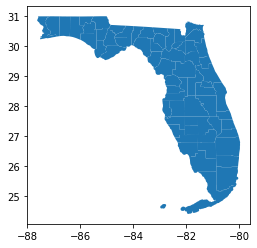

In [68]:
new_data.plot();

In [69]:
carto_test = pd.read_csv("carto_test.csv")
carto_test.head()

,the_geom,cartodb_id,county_name,right_cartodb_id,right_field_1,right_county_name,right_jan2020_sum,right_feb2020_sum,right_mar2020_sum,right_apr2020_sum,right_may2020_sum,right_jun2020_sum,right_jul2020_sum,right_aug2020_sum,right_sep2020_sum,right_oct2020_sum,right_nov2020_sum,right_dec2020_sum,right_jan2021_sum,right_feb2021_sum,right_mar2021_sum,right_apr2021_sum,right_may2021_sum,right_jun2021_sum,right_jul2021_sum,right_aug2021_sum,right_sep2021_sum,right_oct2021_sum,right_nov2021_sum,right_dec2021_sum,right_jan2022_sum,right_feb2022_sum,right_mar2022_sum,right_apr2022_sum,right_may2022_sum,right_jun2022_sum
0,0106000020E6100000010000000103000000010000004D...,1,Alachua County,1,0,Alachua County,0,0,652,5697,10272,18900,74075,140131,202872,290024,353769,445187,572062,608457,709065,721548,777701,762210,812689,954470,1101442,1210471,1193842,1258827,1622418,1834135,2094176,2045463,2148291,1214761
1,0106000020E61000000100000001030000000100000032...,2,Baker County,2,1,Baker County,0,0,60,492,787,1105,6255,28887,40493,51374,57339,69560,86355,89774,103174,102613,108982,107081,121655,150984,172178,184546,179785,187006,212376,235856,267820,260284,270321,149382
2,0106000020E6100000010000000103000000010000002C...,3,Bay County,3,2,Bay County,0,0,40,1323,2615,5501,54683,145756,172265,199748,230240,315397,437472,500460,595719,591102,630995,603887,656049,810344,904305,977432,955973,996066,1147753,1247116,1412066,1371171,1426408,794124
3,0106000020E61000000100000001030000000100000074...,4,Bradford County,4,3,Bradford County,0,0,13,890,1524,1794,5345,17101,28725,36921,39598,53747,76191,77552,89559,88574,93867,91551,102909,128133,151470,164623,160229,166408,187903,203711,231160,224488,233983,129825
4,0106000020E61000000100000001030000000100000011...,5,Brevard County,5,4,Brevard County,0,0,210,5139,11085,23466,117966,199982,244389,319679,410162,568114,791573,895228,1106864,1172335,1306270,1287756,1435048,1857842,2261298,2479186,2433184,2562204,3272755,3612696,4110229,4007530,4229505,2408525


In [70]:
carto_test.columns = carto_test.columns.str.replace("right_", "")
carto_test.head()

,the_geom,cartodb_id,county_name,cartodb_id,field_1,county_name,jan2020_sum,feb2020_sum,mar2020_sum,apr2020_sum,may2020_sum,jun2020_sum,jul2020_sum,aug2020_sum,sep2020_sum,oct2020_sum,nov2020_sum,dec2020_sum,jan2021_sum,feb2021_sum,mar2021_sum,apr2021_sum,may2021_sum,jun2021_sum,jul2021_sum,aug2021_sum,sep2021_sum,oct2021_sum,nov2021_sum,dec2021_sum,jan2022_sum,feb2022_sum,mar2022_sum,apr2022_sum,may2022_sum,jun2022_sum
0,0106000020E6100000010000000103000000010000004D...,1,Alachua County,1,0,Alachua County,0,0,652,5697,10272,18900,74075,140131,202872,290024,353769,445187,572062,608457,709065,721548,777701,762210,812689,954470,1101442,1210471,1193842,1258827,1622418,1834135,2094176,2045463,2148291,1214761
1,0106000020E61000000100000001030000000100000032...,2,Baker County,2,1,Baker County,0,0,60,492,787,1105,6255,28887,40493,51374,57339,69560,86355,89774,103174,102613,108982,107081,121655,150984,172178,184546,179785,187006,212376,235856,267820,260284,270321,149382
2,0106000020E6100000010000000103000000010000002C...,3,Bay County,3,2,Bay County,0,0,40,1323,2615,5501,54683,145756,172265,199748,230240,315397,437472,500460,595719,591102,630995,603887,656049,810344,904305,977432,955973,996066,1147753,1247116,1412066,1371171,1426408,794124
3,0106000020E61000000100000001030000000100000074...,4,Bradford County,4,3,Bradford County,0,0,13,890,1524,1794,5345,17101,28725,36921,39598,53747,76191,77552,89559,88574,93867,91551,102909,128133,151470,164623,160229,166408,187903,203711,231160,224488,233983,129825
4,0106000020E61000000100000001030000000100000011...,5,Brevard County,5,4,Brevard County,0,0,210,5139,11085,23466,117966,199982,244389,319679,410162,568114,791573,895228,1106864,1172335,1306270,1287756,1435048,1857842,2261298,2479186,2433184,2562204,3272755,3612696,4110229,4007530,4229505,2408525


In [71]:
carto_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 67 entries, 0 to 66
Data columns (total 36 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   the_geom     67 non-null     object
 1   cartodb_id   67 non-null     int64 
 2   county_name  67 non-null     object
 3   cartodb_id   67 non-null     int64 
 4   field_1      67 non-null     int64 
 5   county_name  67 non-null     object
 6   jan2020_sum  67 non-null     int64 
 7   feb2020_sum  67 non-null     int64 
 8   mar2020_sum  67 non-null     int64 
 9   apr2020_sum  67 non-null     int64 
 10  may2020_sum  67 non-null     int64 
 11  jun2020_sum  67 non-null     int64 
 12  jul2020_sum  67 non-null     int64 
 13  aug2020_sum  67 non-null     int64 
 14  sep2020_sum  67 non-null     int64 
 15  oct2020_sum  67 non-null     int64 
 16  nov2020_sum  67 non-null     int64 
 17  dec2020_sum  67 non-null     int64 
 18  jan2021_sum  67 non-null     int64 
 19  feb2021_sum  67 non-null     in

In [72]:
carto_test.columns.get_loc("jan2020_sum") #find column position

6

In [73]:
cols = carto_test.columns[6:36] #converts all months to datetime format
carto_test[cols] = carto_test[cols].apply(pd.to_datetime)

In [74]:
carto_test.head()

,the_geom,cartodb_id,county_name,cartodb_id,field_1,county_name,jan2020_sum,feb2020_sum,mar2020_sum,apr2020_sum,may2020_sum,jun2020_sum,jul2020_sum,aug2020_sum,sep2020_sum,oct2020_sum,nov2020_sum,dec2020_sum,jan2021_sum,feb2021_sum,mar2021_sum,apr2021_sum,may2021_sum,jun2021_sum,jul2021_sum,aug2021_sum,sep2021_sum,oct2021_sum,nov2021_sum,dec2021_sum,jan2022_sum,feb2022_sum,mar2022_sum,apr2022_sum,may2022_sum,jun2022_sum
0,0106000020E6100000010000000103000000010000004D...,1,Alachua County,1,0,Alachua County,1970-01-01,1970-01-01,1970-01-01 00:00:00.000000652,1970-01-01 00:00:00.000005697,1970-01-01 00:00:00.000010272,1970-01-01 00:00:00.000018900,1970-01-01 00:00:00.000074075,1970-01-01 00:00:00.000140131,1970-01-01 00:00:00.000202872,1970-01-01 00:00:00.000290024,1970-01-01 00:00:00.000353769,1970-01-01 00:00:00.000445187,1970-01-01 00:00:00.000572062,1970-01-01 00:00:00.000608457,1970-01-01 00:00:00.000709065,1970-01-01 00:00:00.000721548,1970-01-01 00:00:00.000777701,1970-01-01 00:00:00.000762210,1970-01-01 00:00:00.000812689,1970-01-01 00:00:00.000954470,1970-01-01 00:00:00.001101442,1970-01-01 00:00:00.001210471,1970-01-01 00:00:00.001193842,1970-01-01 00:00:00.001258827,1970-01-01 00:00:00.001622418,1970-01-01 00:00:00.001834135,1970-01-01 00:00:00.002094176,1970-01-01 00:00:00.002045463,1970-01-01 00:00:00.002148291,1970-01-01 00:00:00.001214761
1,0106000020E61000000100000001030000000100000032...,2,Baker County,2,1,Baker County,1970-01-01,1970-01-01,1970-01-01 00:00:00.000000060,1970-01-01 00:00:00.000000492,1970-01-01 00:00:00.000000787,1970-01-01 00:00:00.000001105,1970-01-01 00:00:00.000006255,1970-01-01 00:00:00.000028887,1970-01-01 00:00:00.000040493,1970-01-01 00:00:00.000051374,1970-01-01 00:00:00.000057339,1970-01-01 00:00:00.000069560,1970-01-01 00:00:00.000086355,1970-01-01 00:00:00.000089774,1970-01-01 00:00:00.000103174,1970-01-01 00:00:00.000102613,1970-01-01 00:00:00.000108982,1970-01-01 00:00:00.000107081,1970-01-01 00:00:00.000121655,1970-01-01 00:00:00.000150984,1970-01-01 00:00:00.000172178,1970-01-01 00:00:00.000184546,1970-01-01 00:00:00.000179785,1970-01-01 00:00:00.000187006,1970-01-01 00:00:00.000212376,1970-01-01 00:00:00.000235856,1970-01-01 00:00:00.000267820,1970-01-01 00:00:00.000260284,1970-01-01 00:00:00.000270321,1970-01-01 00:00:00.000149382
2,0106000020E6100000010000000103000000010000002C...,3,Bay County,3,2,Bay County,1970-01-01,1970-01-01,1970-01-01 00:00:00.000000040,1970-01-01 00:00:00.000001323,1970-01-01 00:00:00.000002615,1970-01-01 00:00:00.000005501,1970-01-01 00:00:00.000054683,1970-01-01 00:00:00.000145756,1970-01-01 00:00:00.000172265,1970-01-01 00:00:00.000199748,1970-01-01 00:00:00.000230240,1970-01-01 00:00:00.000315397,1970-01-01 00:00:00.000437472,1970-01-01 00:00:00.000500460,1970-01-01 00:00:00.000595719,1970-01-01 00:00:00.000591102,1970-01-01 00:00:00.000630995,1970-01-01 00:00:00.000603887,1970-01-01 00:00:00.000656049,1970-01-01 00:00:00.000810344,1970-01-01 00:00:00.000904305,1970-01-01 00:00:00.000977432,1970-01-01 00:00:00.000955973,1970-01-01 00:00:00.000996066,1970-01-01 00:00:00.001147753,1970-01-01 00:00:00.001247116,1970-01-01 00:00:00.001412066,1970-01-01 00:00:00.001371171,1970-01-01 00:00:00.001426408,1970-01-01 00:00:00.000794124
3,0106000020E61000000100000001030000000100000074...,4,Bradford County,4,3,Bradford County,1970-01-01,1970-01-01,1970-01-01 00:00:00.000000013,1970-01-01 00:00:00.000000890,1970-01-01 00:00:00.000001524,1970-01-01 00:00:00.000001794,1970-01-01 00:00:00.000005345,1970-01-01 00:00:00.000017101,1970-01-01 00:00:00.000028725,1970-01-01 00:00:00.000036921,1970-01-01 00:00:00.000039598,1970-01-01 00:00:00.000053747,1970-01-01 00:00:00.000076191,1970-01-01 00:00:00.000077552,1970-01-01 00:00:00.000089559,1970-01-01 00:00:00.000088574,1970-01-01 00:00:00.000093867,1970-01-01 00:00:00.000091551,1970-01-01 00:00:00.000102909,1970-01-01 00:00:00.000128133,1970-01-01 00:00:00.000151470,1970-01-01 00:00:00.000164623,1970-01-01 00:00:00.000160

In [75]:
#carto_test.to_csv('newcartotest.csv')

In [76]:
#joined_gdf = grouped_gj.merge(map_df2, on='County Name')
#joined_gdf.head()

###### Restructure dataframe for time series map

In [77]:
map_df = fl_month2020b.melt(id_vars=["County Name"],
                           var_name="Date",
                           value_name="Covid Cases")
                           #ignore_index=True) #.sort_values('County Name')

map_df.head()

,County Name,Date,Covid Cases
0,Alachua County,Jan2020_Sum,0
1,Baker County,Jan2020_Sum,0
2,Bay County,Jan2020_Sum,0
3,Bradford County,Jan2020_Sum,0
4,Brevard County,Jan2020_Sum,0


In [78]:
#try and find way to sort by county name and keep date order

In [79]:
map_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2010 entries, 0 to 2009
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   County Name  2010 non-null   object
 1   Date         2010 non-null   object
 2   Covid Cases  2010 non-null   int64 
dtypes: int64(1), object(2)
memory usage: 47.2+ KB


In [80]:
#start with list of months to set order
months = ["Jan2020_Sum", "Feb2020_Sum", "Mar2020_Sum", "Apr2020_Sum", "May2020_Sum", "Jun2020_Sum", 
          "Jul2020_Sum", "Aug2020_Sum", "Sep2020_Sum", "Oct2020_Sum", "Nov2020_Sum", "Dec2020_Sum", "Jan2021_Sum", "Feb2021_Sum", "Mar2021_Sum", "Apr2021_Sum", "May2021_Sum", "Jun2021_Sum", 
          "Jul2021_Sum", "Aug2021_Sum", "Sep2021_Sum", "Oct2021_Sum", "Nov2021_Sum", "Dec2021_Sum", "Jan2022_Sum", "Feb2022_Sum", "Mar2022_Sum", "Apr2022_Sum", "May2022_Sum", "Jun2022_Sum"]

#adds new column 'months', specify categories, pandas remembers order from 'months' list
map_df['months'] = pd.Categorical(map_df['Date'], categories=months, ordered=True)

#sorts df by new 'month' column which has order from list
map_df.sort_values(by='months',inplace=True)  

map_df.head()

,County Name,Date,Covid Cases,months
0,Alachua County,Jan2020_Sum,0,Jan2020_Sum
36,Levy County,Jan2020_Sum,0,Jan2020_Sum
37,Liberty County,Jan2020_Sum,0,Jan2020_Sum
38,Madison County,Jan2020_Sum,0,Jan2020_Sum
39,Manatee County,Jan2020_Sum,0,Jan2020_Sum


In [81]:
map_df.sort_values('County Name')

,County Name,Date,Covid Cases,months
0,Alachua County,Jan2020_Sum,0,Jan2020_Sum
1005,Alachua County,Apr2021_Sum,721548,Apr2021_Sum
469,Alachua County,Aug2020_Sum,140131,Aug2020_Sum
1072,Alachua County,May2021_Sum,777701,May2021_Sum
402,Alachua County,Jul2020_Sum,74075,Jul2020_Sum
1139,Alachua County,Jun2021_Sum,762210,Jun2021_Sum
1206,Alachua County,Jul2021_Sum,812689,Jul2021_Sum
335,Alachua County,Jun2020_Sum,18900,Jun2020_Sum
1273,Alachua County,Aug2021_Sum,954470,Aug2021_Sum
1876,Alachua County,May2022_Sum,2148291,May2022_Sum


In [82]:
map_df2 = map_df.sort_values(['County Name', 'months'],
                            ascending= [True, True])
map_df2

,County Name,Date,Covid Cases,months
0,Alachua County,Jan2020_Sum,0,Jan2020_Sum
67,Alachua County,Feb2020_Sum,0,Feb2020_Sum
134,Alachua County,Mar2020_Sum,652,Mar2020_Sum
201,Alachua County,Apr2020_Sum,5697,Apr2020_Sum
268,Alachua County,May2020_Sum,10272,May2020_Sum
335,Alachua County,Jun2020_Sum,18900,Jun2020_Sum
402,Alachua County,Jul2020_Sum,74075,Jul2020_Sum
469,Alachua County,Aug2020_Sum,140131,Aug2020_Sum
536,Alachua County,Sep2020_Sum,202872,Sep2020_Sum
603,Alachua County,Oct2020_Sum,290024,Oct2020_Sum


In [90]:
map_df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2010 entries, 0 to 2009
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   County Name  2010 non-null   object  
 1   Date         2010 non-null   object  
 2   Covid Cases  2010 non-null   int64   
 3   months       2010 non-null   category
dtypes: category(1), int64(1), object(2)
memory usage: 66.1+ KB


In [83]:
#map_df2.to_csv('map_df2.csv')

##### Combining geometry to dataframe

df = df.replace(r"^ +| +$", r"", regex=True)

Explanation for the regex:

^ is line start

(space and plus, +) is one or more spaces

| is or

$ is line end.

So it searches for leading (line start and spaces) and trailing (spaces and line end) spaces and replaces them with an empty string.

In [95]:
new_grouped_gj = grouped_gj.replace(r"^ +| +$", r"", regex=True) #checks for whitespace and removes if found 

In [98]:
new_grouped_gj.head()

,County Name,geometry
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726..."
1,Baker County,"POLYGON ((-82.10107 30.36279, -82.10101 30.362..."
2,Bay County,"POLYGON ((-85.99565 30.28131, -85.99562 30.282..."
3,Bradford County,"POLYGON ((-82.27400 29.99832, -82.27398 29.998..."
4,Brevard County,"POLYGON ((-80.86158 28.24656, -80.86155 28.247..."


In [99]:
new_map_df2 = map_df2.replace(r"^ +| +$", r"", regex=True)
new_map_df2.head()

,County Name,Date,Covid Cases,months
0,Alachua County,Jan2020_Sum,0,Jan2020_Sum
67,Alachua County,Feb2020_Sum,0,Feb2020_Sum
134,Alachua County,Mar2020_Sum,652,Mar2020_Sum
201,Alachua County,Apr2020_Sum,5697,Apr2020_Sum
268,Alachua County,May2020_Sum,10272,May2020_Sum


In [112]:
joined_gdf = new_grouped_gj.merge(new_map_df2, on='County Name')
joined_gdf.head()

,County Name,geometry,Date,Covid Cases,months
0,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Jan2020_Sum,0,Jan2020_Sum
1,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Feb2020_Sum,0,Feb2020_Sum
2,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Mar2020_Sum,652,Mar2020_Sum
3,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",Apr2020_Sum,5697,Apr2020_Sum
4,Alachua County,"POLYGON ((-82.65704 29.72664, -82.65703 29.726...",May2020_Sum,10272,May2020_Sum


In [111]:
#joined_gdf.to_json('joined_gdf.json')

In [108]:
joined_gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Int64Index: 2010 entries, 0 to 2009
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   County Name  2010 non-null   object  
 1   geometry     2010 non-null   geometry
 2   Date         2010 non-null   object  
 3   Covid Cases  2010 non-null   int64   
 4   months       2010 non-null   category
dtypes: category(1), geometry(1), int64(1), object(2)
memory usage: 81.8+ KB
